<a href="https://colab.research.google.com/github/SynBioExplorer/IronHack_Final_Project/blob/main/final_project_iron_hack.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
!apt-get install libproj-dev proj-data proj-bin
!apt-get install libgeos-dev
!pip install cython
!pip install cartopy
!pip install tqdm
!pip install geopandas
!pip install -U -q PyDrive
!pip install -U pandas-profiling[notebook]

Reading package lists... Done
Building dependency tree       
Reading state information... Done
proj-data is already the newest version (4.9.3-2).
proj-data set to manually installed.
The following NEW packages will be installed:
  libproj-dev proj-bin
0 upgraded, 2 newly installed, 0 to remove and 14 not upgraded.
Need to get 232 kB of archives.
After this operation, 1,220 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 libproj-dev amd64 4.9.3-2 [199 kB]
Get:2 http://archive.ubuntu.com/ubuntu bionic/universe amd64 proj-bin amd64 4.9.3-2 [32.3 kB]
Fetched 232 kB in 0s (2,148 kB/s)
Selecting previously unselected package libproj-dev:amd64.
(Reading database ... 144865 files and directories currently installed.)
Preparing to unpack .../libproj-dev_4.9.3-2_amd64.deb ...
Unpacking libproj-dev:amd64 (4.9.3-2) ...
Selecting previously unselected package proj-bin.
Preparing to unpack .../proj-bin_4.9.3-2_amd64.deb ...
Unpacking proj-bin (

In [3]:
import pandas as pd
import numpy as np
from google.colab import files
import os
import glob
import io
import seaborn as sns
import cv2
import matplotlib.pyplot as plt
%matplotlib inline
from cartopy import crs as ccrs
import geopandas as gpd
import cartopy.crs as ccrs
pd.set_option('display.max_columns', None)
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials# Authenticate and create the PyDrive client.
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)
import cufflinks as cf
import plotly.offline
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)
from tqdm import tqdm_notebook
from matplotlib.pyplot import figure

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


df1= contextual info aabout each country (political, socioeconomic, water resoureces, water use) from UN
df2 = river basins  
df3 = water conflict data
df4 = water treaties


In [5]:
df1 = pd.read_excel('/content/drive/MyDrive/Colab Notebooks/aquastat data/combined_tables.xlsx')

In [6]:
df2 = gpd.read_file('/content/drive/MyDrive/Colab Notebooks/river basins/BCU310_Master_20180511.shp')

In [7]:
df3 = pd.read_excel('/content/drive/MyDrive/Colab Notebooks/aquastat data/water_conflict.xls')

In [8]:
df4 = pd.read_excel('/content/drive/MyDrive/Colab Notebooks/treaties.xlsx')

In [9]:
#df1 is external data and only possibly used to supplement factors, primary focus is on df2,3,4 

In [10]:
df1

,Country,Time,Total area of the country (excl. coastal waters) (1000 ha),Arable land area (1000 ha),Permanent crops area (1000 ha),Cultivated area (arable land + permanent crops) (1000 ha),% of total country area cultivated (%),Total population (1000 inhab),Rural population (1000 inhab),Urban population (1000 inhab),Population density (inhab/km2),Gross Domestic Product (GDP) (current US$),GDP per capita (current US$/inhab),"Agriculture, value added (% GDP) (%)",Human Development Index (HDI) [highest = 1] (-),Gender Inequality Index (GII) [equality = 0; inequality = 1) (-),Prevalence of undernourishment (3-year average) (%),Number of people undernourished (3-year average) (1000 inhab),Long-term average annual precipitation in volume (10^9 m3/year),National Rainfall Index (NRI) (mm/year),Total internal renewable water resources per capita (m3/inhab/year),Surface water: entering the country (total) (10^9 m3/year),Surface water: inflow not submitted to treaties (10^9 m3/year),Surface water: inflow submitted to treaties (10^9 m3/year),Surface water: inflow secured through treaties (10^9 m3/year),Surface water: total flow of border rivers (10^9 m3/year),Surface water: accounted flow of border rivers (10^9 m3/year),Surface water: accounted inflow (10^9 m3/year),Surface water: leaving the country to other countries (total) (10^9 m3/year),Surface water: outflow to other countries not submitted to treaties (10^9 m3/year),Surface water: outflow to other countries submitted to treaties (10^9 m3/year),Surface water: outflow to other countries secured through treaties (10^9 m3/year),Surface water: total external renewable (10^9 m3/year),Groundwater: entering the country (total) (10^9 m3/year),Groundwater: accounted inflow (10^9 m3/year),Groundwater: leaving the country to other countries (total) (10^9 m3/year),Groundwater: accounted outflow to other countries (10^9 m3/year),Water resources: total external renewable (10^9 m3/year),Total renewable water resources per capita (m3/inhab/year),Total exploitable water resources (10^9 m3/year),Interannual variability (WRI) (-),Seasonal variability (WRI) (-),Total dam capacity (km3),Dam capacity per capita (m3/inhab),Agricultural water withdrawal (10^9 m3/year),Industrial water withdrawal (10^9 m3/year),Municipal water withdrawal (10^9 m3/year),Total water withdrawal (10^9 m3/year),Irrigation water withdrawal (10^9 m3/year),Irrigation water requirement (10^9 m3/year),Agricultural water withdrawal as % of total water withdrawal (%),Industrial water withdrawal as % of total water withdrawal (%),Municipal water withdrawal as % of total withdrawal (%),Total water withdrawal per capita (m3/inhab/year),Environmental Flow Requirements (10^9 m3/year),Fresh surface water withdrawal (10^9 m3/year),Fresh groundwater withdrawal (10^9 m3/year),Total freshwater withdrawal (10^9 m3/year),Desalinated water produced (10^9 m3/year),Direct use of treated municipal wastewater (10^9 m3/year),Direct use of agricultural drainage water (10^9 m3/year),MDG 7.5. Freshwater withdrawal as % of total renewable water resources (%),Agricultural water withdrawal as % of total renewable water resources (%),SDG 6.4.2. Water Stress (%),Flood occurrence (WRI) (-),Total population with access to safe drinking-water (JMP) (%),Rural population with access to safe drinking-water (JMP) (%),Urban population with access to safe drinking-water (JMP) (%)
0,Afghanistan,1958-1962,65286.0,7700.0,60.0,7760.0,32813.0,9346.0,8541.0,804.9,14.32,54666667800000000,58.49,NaN,NaN,NaN,NaN,NaN,213.5,NaN,5045.0,10.0,10.0,0.0,0.0,33.4,9.0,19.0,42.22,35.52,44018.0,0.82,18.18,0.0,0.0,NaN,NaN,18.18,6990.0,NaN,NaN,NaN,43862.00,128.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,28.29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Afghanistan,1963-1967,65286.0,7844.0,135.0,7979.0,44896.0,10373.0,9307.0,1066.0,15.89,1673333419000000000,161.30,NaN,NaN,NaN,NaN,NaN,213.5,307.0,4545.0,10.0,10.0,0.0,0.0,33.4,9.0,19.0,42.22,35.52,44018.0,0.82,18.18,0.0,0.0,NaN,NaN,18.18

In [11]:
df2

,adm0_name,FIRST_stat,BCODE,CCODE,BCCODE,Alt_CCODE,Basin_Name,Continent_,Area_km2,Pop_2015,PopDen2015,Pop_2007,PopDen2007,Pop_2020,PopDen2020,Pop_2012_P,PopDen12_P,Dams_Exist,Dam_Plnd,runoff,withdrawal,consumpt,HydroPolTe,InstitVuln,geometry
0,Uzbekistan,Member State,ARAL,UZB,ARAL_UZB,None,Aral Sea,AS,375912,29312241,78,26345757,70,31183626,83,31456410,84,9,1,47.26773828,53973.951,30125.426,3,5,"MULTIPOLYGON (((7993575.448 4076673.282, 79926..."
1,Côte d'Ivoire,Member State,CSTO,CIV,CSTO_CIV,None,Cestos,AF,2228,341548,153,312408,140,381366,171,502373,225,0,0,1307.800539,4.565,0.728,3,0,"POLYGON ((-932282.494 835344.422, -931671.780 ..."
2,Afghanistan,Member State,HLMD,AFG,HLMD_AFG,None,Helmand,AS,312289,8733017,28,7949240,25,9468651,30,9586618,31,2,0,86.61935698,32941.578,12540.323,2,2,"MULTIPOLYGON (((7591553.128 3343992.779, 75915..."
3,Pakistan,Member State,INDU,PAK,INDU_PAK,None,Indus,AS,429387,170389455,397,126441454,294,188654978,439,191967727,447,23,26,95.69988656,244313.92,87784.458,3,5,"MULTIPOLYGON (((7588764.346 3345971.710, 75891..."
4,Cameroon,Member State,AKPA,CMR,AKPA_CMR,None,Akpa,AF,577,18933,33,18914,33,20046,35,25099,43,0,0,1540.953293,3.539,0.69,3,0,"MULTIPOLYGON (((985177.493 594406.108, 985108...."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
807,Syrian Arab Republic,Member State,TIGR,SYR,TIGR_SYR,None,Tigris-Euphrates/Shatt al Arab,AS,114015,8769876,77,8627355,76,9995876,88,11365684,100,1,0,83.66358936,13644.495,7669.552,4,3,"MULTIPOLYGON (((4714800.531 3827592.929, 47151..."
808,Turkey,Member State,TIGR,TUR,TIGR_TUR,None,Tigris-Euphrates/Shatt al Arab,AS,175794,12517849,71,11189257,64,13051216,74,15087641,86,19,1,278.3731605,19567.232,11035.591,3,4,"POLYGON ((4937638.413 3939770.562, 4937994.557..."
809,Viet Nam,Member State,MEKO,VNM,MEKO_VNM,None,Mekong,AS,46483,16399998,353,11377324,245,16934279,364,17968869,387,1,0,1058.064551,10326.793,3744.45,3,5,"MULTIPOLYGON (((11701578.917 1204178.686, 1170..."
810,Bangladesh,Member State,NAAF,BGD,NAAF_BGD,None,Naaf River,AS,392,433341,1105,258900,660,481309,1228,475150,1212,0,0,N/A,N/A,N/A,N/A,N/A,"POLYGON ((10263894.876 2287301.055, 10263763.0..."


In [12]:
df3

,ID,UNIQUE_ID,Interaction_ID,ID1,EVENT_MASTER,GROUPED_ID,BAR_ID,SOURCE_ID,DATE,DYAD_CODE,BCode,NUMBER_OF_BASINS,LOCATION,CCODE1,CCODE2,IRM1,IRM2,BCCODE1,BCCODE2,COUNTRY_LIST,NUMBER_OF_Countries,COPDAB_SCALE,BAR_Scale,EVENT_TYPE,EVENT_SUMMARY,Issue_Type1,Issue_Type2,Macro_Event,Comments,SOURCE,Source_Source,KLL_Categ,FBIS_Region,DOC_DATE,EVENT_ISSUE,KLL_ISSUE_NUMBER
0,1,1,1,2.0,3.0,C1,C1,431019,1948-03-16,EGY_INT,NILE,1.0,NILE,EGY,INT,M,M,NILE_EGY,NILE_INT,Egypt (internal),1.0,5.0,3.0,n/a-internal,Egypt lays to four foundation stone of Aswan h...,3.0,0.0,Aswan Dam,NaN,COPDAB,Arab World,NaN,NaN,NaN,NaN,NaN
1,2,2,1,3.0,4.0,W17,W17,NaN,1948-04-01,IND_PAK,INDU,1.0,Indus,IND,PAK,I,R,INDU_IND,INDU_PAK,India--Pakistan,2.0,11.0,-3.0,y,"The ""Standstill Agreement"" between India and P...",2.0,0.0,"Indus Water Sharing, IND-PAK",NaN,Wolf,Wolf - Indus Water Treaty Case Study (Time Line),NaN,NaN,NaN,NaN,NaN
2,3,3,1,4.0,5.0,W18,W18,NaN,1948-05-04,IND_PAK,INDU,1.0,Indus,IND,PAK,I,R,INDU_IND,INDU_PAK,India--Pakistan,2.0,5.0,3.0,y,At an Inter-Dominian conference between India ...,2.0,0.0,"Indus Water Sharing, IND-PAK",NaN,Wolf,Wolf - Indus Water Treaty Case Study (Time Line),NaN,NaN,NaN,NaN,NaN
3,4,4,1,5.0,6.0,C2,C2,431014,1948-07-08,FRA_ITA,ROIA,1.0,ROIA,FRA,ITA,R,I,ROIA_FRA,ROIA_ITA,France--Italy,2.0,4.0,4.0,y,Italy and France build dam on Roya River in ex...,10.0,0.0,NaN,"Francence/Italy basin, aka ROYA",COPDAB,Keesing's Contemporary Archives,NaN,NaN,NaN,NaN,NaN
4,5,5,1,36.0,37.0,C3,C3A,430968,1948-07-30,CZS_GBR,DANU,1.0,DANUBE,CZS,GBR,M,M,DANU_CZS,DANU_GBR,Austria--Czechoslovakia--Great Britain--France...,8.0,7.0,1.0,ExVar,"Austria, Czechoslovakia, Great Britain, France...",8.0,0.0,Danube Joint Management,NaN,COPDAB,New Times: A Weekly Journal of World Affairs (...,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7123,7184,4026,3,2138.0,2105.0,F372,F372F,372a,1980-06-03,GMB_SEN,GAMB,1.0,Gambia,GMB,SEN,M,M,GAMB_GMB,GAMB_SEN,Gambia --Guinea--Senegal,4.0,6.0,1.0,n/a-contextual information,"Senghor, the Senegal Minister of State for Equ...",10.0,8.0,NaN,Guinea MEMBERSHIP in Gambia river development ...,WNC (FBIS),Paris AFP,2,afr,6/3/1980,organization--dams,2b8
7124,7185,4027,1,812.0,740.0,C391,C391,398713,1959-06-09,IND_PAK,INDU,1.0,INDUS,IND,PAK,M,M,INDU_IND,INDU_PAK,India--Pakistan,2.0,5.0,3.0,y,India and Pakistan agree canal waters issue,2.0,0.0,"Indus Water Sharing, IND-PAK",NaN,COPDAB,Asian Recorder (India),NaN,NaN,NaN,NaN,NaN
7125,7186,4028,1,1736.0,1722.0,G21,G21,202096,1973-11-05,MLI_INT,NTAP,0.0,Mali,MLI,INT,M,M,NTAP_MLI,NTAP_INT,Mali (internal),2.0,5.0,3.0,n/a-disease,Mali announces progress against river blindness,11.0,0.0,NaN,NaN,COPDAB,NaN,NaN,NaN,NaN,NaN,NaN
7126,7187,4029,1,806.0,734.0,C384,C384,346274,1959-05-05,ISR_INT,JORD,1.0,JORDAN,ISR,INT,M,M,JORD_ISR,JORD_INT,Israel (internal),1.0,5.0,3.0,n/a-internal,Israel constructs work on 2 water pipelines,2.0,10.0,NaN,"internal, but...",COPDAB,Middle Eastern Affairs,NaN,NaN,NaN,NaN,NaN


In [13]:
df4

,Entry ID,BCCODE,BCODE,Basin Name,CCODE,Country_Name,2016Update ID,2010_TREATY_DocID,TFDDID,Unified Primary 2016 Treaty ID,Primary2010_Treaty_DocID,PrimaryTFDDID,TFDDID Linkage,DocID Linkage,DocumentName,DateSigned,Signatories,DocType,Format,Source,Notes,LocationSigned,Region_Continent,PRIMARY_COUNTRY_SUBREGION,Treaty Basin(s),TFDD Basin(s),NumberParties,AdditionalComments,MinorAgreement,Reference to Precedence,Agreement Purpose,GeoScope,Issue Area,RBO,Infrastructure,Allocation,Alloc_Article,Alloc_Text,Hydropower,Hydro_Article,Hydropower_Text,Irrigation,Irrigation_Article,Groundwater,Groundwater_Article,Environment,Enviro_Article,Equity_Sustainability,Equity_Article,Equity_Sustainability_Text,LocalNeeds,LocalNeeds_Article,Construct_Right,Construct_Article,Construct_Ban,ConstructBan_Article,PriorNotification,PriorNotif_Article,Navigation,Nav_Article,Fishing,Fish_Article,BorderIssues,Border_Article,TerritorialIssues,Territorial_Article,NonWater Linkage,NonWater_Article,NonWaterLink_Comments,NonWater_Embed,Uncertainty Explicit,UncertExplicit_Article,VarMgmt,VarMgmt_Article,NeedsVariability,NeedsVar_Article,AltScenarios,AltScen_Article,PredictionModel,PredictionModel_Article,JointMgmt,JointMgmt_Article,CommName,TechCoop,TechCoop_Article,InfoExchange,InfoExchange_Article,Monitoring,Monitoring_Article,Conflict Resolution Mechanism,ConflictRes_Article,AgreeFinance,AgreeFinance_Article,StakeholderParticip,Stakeholder_Article,Consultations,Consulations_Article,Compensation,Compensation_Article,National_Prog_Law,NationalLaws_Article,NonSig_Riparians,NonSigInterests_Article,People_Interests,PeoplesInterests_Article,AmendMech,AmendMech_Article,Precedent_NotEst,PrecedentNotEst_Article,Precedent_Est,PrecedentEst_Article,Enforcement,EnforceMech,WaterDiv_Method,Basin_Name
0,1051.0,MEKO_CHN,MEKO,Mekong,CHN,China,623.0,1070,NaN,0.0,NaN,NaN,0,0,Agreement on Providing the Hydrologic Data dur...,2002-04-01 00:00:00,"Cambodia, China, Lao PDR,Thailand, Vietnam",-1,NaN,NaN,"According to the agreement, China will provide...",N.A.,Asia,East Asia,Mekong,Mekong,2,NaN,N.A.,0,0,0,NaN,N.A.,N.A.,-1,NaN,NaN,N.A.,NaN,NaN,N.A.,NaN,N.A.,NaN,-1,NaN,N.A.,NaN,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,0,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,NaN,N.A.,-1,NaN,-1,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,-1,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,N.A.,N.A.,N.A.,Mekong
1,839.0,ILIX_CHN,ILIX,Ili/Kunes He,CHN,China,559.0,614,NaN,0.0,NaN,NaN,0,0,Agreement between the Government of the Republ...,2001-09-12 00:00:00,"China, Kazakhstan",4,Electronic,http://faolex.fao.org/,The Contracting Parties pledge to prevent or m...,"Astana, Kazakhstan",Asia,Central Asia,Frontier or shared waters,"Alakol, Ili/Kunes He, Ob, Tarim",1,NaN,N,5,2,3,Joint Management,Y,N,0,NaN,NaN,N,NaN,NaN,N,NaN,N,NaN,-1,NaN,Y,"Preamble, Article 2","""…Equitably and rationally resolving issue bet...",N,NaN,N,NaN,N,NaN,1,NaN,N,NaN,N,NaN,N,NaN,Y,Preamble,None,NaN,NaN,N,1,Article 5,1,"Article 3, 5",N,NaN,N,NaN,Y,Article 5,Y,Article 8,Kazakhstan-China Joint Commission on the use a...,N,NaN,N,Article 6,N,NaN,2,Article 12,N,NaN,N,NaN,Y,Article 9,N,NaN,N,NaN,N,NaN,N,NaN,Y,Article 13,N,NaN,N,NaN,N,NaN,None,Ili/Kunes He
2,1327.0,OBXX_CHN,OBXX,Ob,CHN,China,559.0,614,NaN,0.0,NaN,NaN,0,0,Agreement between the Government of the Republ...,2001-09-12 00:00:00,"China, Kazakhstan",4,Electronic,http://faolex.fao.org/,The Contracting Parties pledge to prevent or m...,"Astana, Kazakhstan",Asia,Central Asia,Frontier or shared waters,"Alakol, Ili/Kunes He, Ob, Tarim",1,NaN,N,5,2,3,Joint Management,Y,N,0,NaN,NaN,N,NaN,NaN,N,NaN,N,NaN,-1,NaN,Y,"Preamble, Article 2","""…Equitably and rationally resolving issue bet...",N,NaN,N,NaN,N,NaN,1,NaN,N,NaN,N,NaN,N,NaN,Y,Preamble,None,NaN,NaN,N,1,Article 5,1,"Article 3, 5",N,NaN,N,NaN,Y,Article 5,Y,Article 8,Kazakhstan-China Joint Commission on the use a...,N,NaN,N,Article 6,N,NaN,2,Article 12,N,NaN,N,NaN,Y,Articl

In [14]:
#all imported - good

In [15]:
import missingno as msno


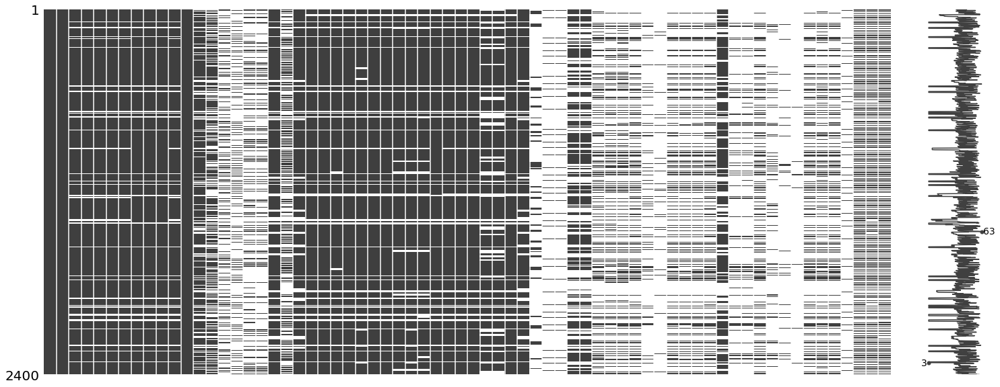

In [16]:
msno.matrix(df1)

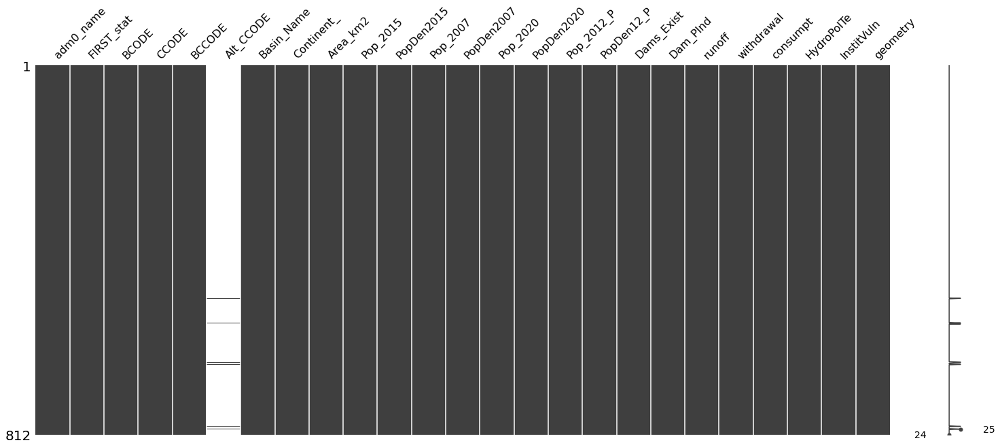

In [17]:
msno.matrix(df2)

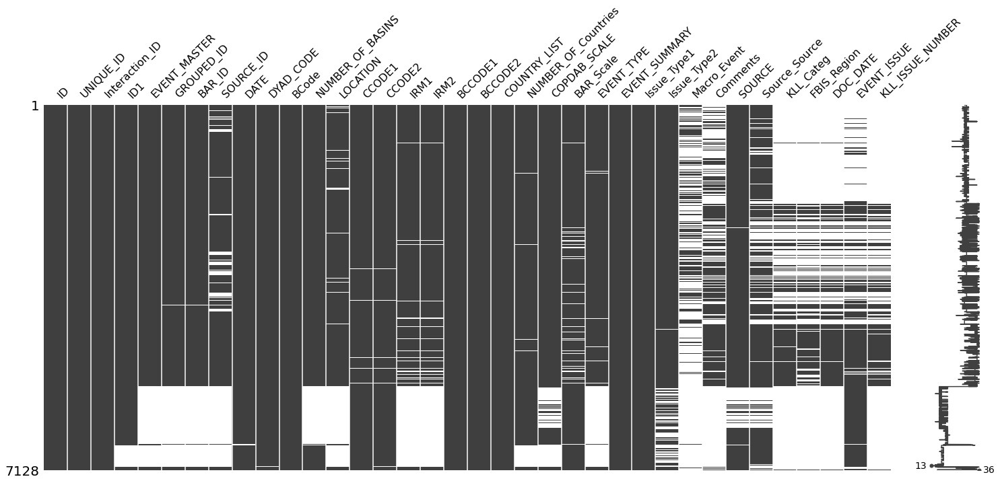

In [18]:
msno.matrix(df3)

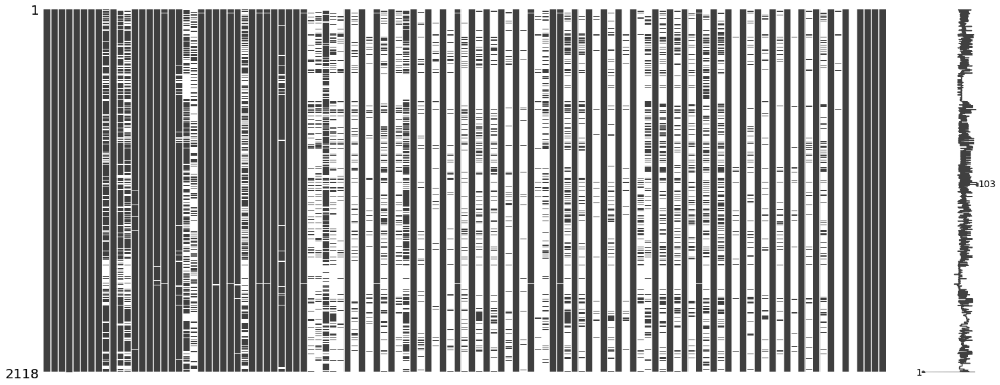

In [19]:
msno.matrix(df4)

In [20]:
#missing data in df1,df3,df4 --> df1 doesnt matter too much, big chunk missing in df3 is gotta get fixed (main dataframe with the output column)

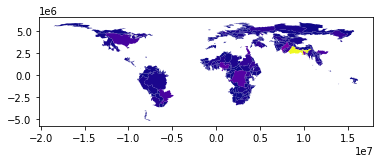

In [21]:
#countries with at least one of the 310 river basins
df2.plot(column='Pop_2020',cmap='plasma')


In [22]:
#lets drop some irrelephant columns

In [23]:
df2.shape

(812, 25)

In [24]:
df2.value_counts

<bound method DataFrame.value_counts of                 adm0_name    FIRST_stat BCODE CCODE    BCCODE Alt_CCODE  \
0              Uzbekistan  Member State  ARAL   UZB  ARAL_UZB      None   
1           Côte d'Ivoire  Member State  CSTO   CIV  CSTO_CIV      None   
2             Afghanistan  Member State  HLMD   AFG  HLMD_AFG      None   
3                Pakistan  Member State  INDU   PAK  INDU_PAK      None   
4                Cameroon  Member State  AKPA   CMR  AKPA_CMR      None   
..                    ...           ...   ...   ...       ...       ...   
807  Syrian Arab Republic  Member State  TIGR   SYR  TIGR_SYR      None   
808                Turkey  Member State  TIGR   TUR  TIGR_TUR      None   
809              Viet Nam  Member State  MEKO   VNM  MEKO_VNM      None   
810            Bangladesh  Member State  NAAF   BGD  NAAF_BGD      None   
811               Myanmar  Member State  NAAF   MMR  NAAF_MMR      None   

                         Basin_Name Continent_  Area_km2   

In [25]:
df2.head()

,adm0_name,FIRST_stat,BCODE,CCODE,BCCODE,Alt_CCODE,Basin_Name,Continent_,Area_km2,Pop_2015,PopDen2015,Pop_2007,PopDen2007,Pop_2020,PopDen2020,Pop_2012_P,PopDen12_P,Dams_Exist,Dam_Plnd,runoff,withdrawal,consumpt,HydroPolTe,InstitVuln,geometry
0,Uzbekistan,Member State,ARAL,UZB,ARAL_UZB,None,Aral Sea,AS,375912,29312241,78,26345757,70,31183626,83,31456410,84,9,1,47.26773828,53973.951,30125.426,3,5,"MULTIPOLYGON (((7993575.448 4076673.282, 79926..."
1,Côte d'Ivoire,Member State,CSTO,CIV,CSTO_CIV,None,Cestos,AF,2228,341548,153,312408,140,381366,171,502373,225,0,0,1307.800539,4.565,0.728,3,0,"POLYGON ((-932282.494 835344.422, -931671.780 ..."
2,Afghanistan,Member State,HLMD,AFG,HLMD_AFG,None,Helmand,AS,312289,8733017,28,7949240,25,9468651,30,9586618,31,2,0,86.61935698,32941.578,12540.323,2,2,"MULTIPOLYGON (((7591553.128 3343992.779, 75915..."
3,Pakistan,Member State,INDU,PAK,INDU_PAK,None,Indus,AS,429387,170389455,397,126441454,294,188654978,439,191967727,447,23,26,95.69988656,244313.92,87784.458,3,5,"MULTIPOLYGON (((7588764.346 3345971.710, 75891..."
4,Cameroon,Member State,AKPA,CMR,AKPA_CMR,None,Akpa,AF,577,18933,33,18914,33,20046,35,25099,43,0,0,1540.953293,3.539,0.69,3,0,"MULTIPOLYGON (((985177.493 594406.108, 985108...."


In [26]:
df2_deleted = df2[['adm0_name','FIRST_stat','Alt_CCODE','BCODE','CCODE']]

In [27]:
df2=df2.drop(columns=['adm0_name','FIRST_stat','Alt_CCODE','BCODE','CCODE'])

In [28]:
####

In [29]:
df3.value_counts

<bound method DataFrame.value_counts of         ID  UNIQUE_ID  Interaction_ID     ID1  EVENT_MASTER GROUPED_ID BAR_ID  \
0        1          1               1     2.0           3.0         C1     C1   
1        2          2               1     3.0           4.0        W17    W17   
2        3          3               1     4.0           5.0        W18    W18   
3        4          4               1     5.0           6.0         C2     C2   
4        5          5               1    36.0          37.0         C3    C3A   
...    ...        ...             ...     ...           ...        ...    ...   
7123  7184       4026               3  2138.0        2105.0       F372  F372F   
7124  7185       4027               1   812.0         740.0       C391   C391   
7125  7186       4028               1  1736.0        1722.0        G21    G21   
7126  7187       4029               1   806.0         734.0       C384   C384   
7127  7190       3706               1  8590.0           NaN        Na

In [30]:
df3.head()

,ID,UNIQUE_ID,Interaction_ID,ID1,EVENT_MASTER,GROUPED_ID,BAR_ID,SOURCE_ID,DATE,DYAD_CODE,BCode,NUMBER_OF_BASINS,LOCATION,CCODE1,CCODE2,IRM1,IRM2,BCCODE1,BCCODE2,COUNTRY_LIST,NUMBER_OF_Countries,COPDAB_SCALE,BAR_Scale,EVENT_TYPE,EVENT_SUMMARY,Issue_Type1,Issue_Type2,Macro_Event,Comments,SOURCE,Source_Source,KLL_Categ,FBIS_Region,DOC_DATE,EVENT_ISSUE,KLL_ISSUE_NUMBER
0,1,1,1,2.0,3.0,C1,C1,431019,1948-03-16,EGY_INT,NILE,1.0,NILE,EGY,INT,M,M,NILE_EGY,NILE_INT,Egypt (internal),1.0,5.0,3.0,n/a-internal,Egypt lays to four foundation stone of Aswan h...,3.0,0.0,Aswan Dam,NaN,COPDAB,Arab World,NaN,NaN,NaN,NaN,NaN
1,2,2,1,3.0,4.0,W17,W17,NaN,1948-04-01,IND_PAK,INDU,1.0,Indus,IND,PAK,I,R,INDU_IND,INDU_PAK,India--Pakistan,2.0,11.0,-3.0,y,"The ""Standstill Agreement"" between India and P...",2.0,0.0,"Indus Water Sharing, IND-PAK",NaN,Wolf,Wolf - Indus Water Treaty Case Study (Time Line),NaN,NaN,NaN,NaN,NaN
2,3,3,1,4.0,5.0,W18,W18,NaN,1948-05-04,IND_PAK,INDU,1.0,Indus,IND,PAK,I,R,INDU_IND,INDU_PAK,India--Pakistan,2.0,5.0,3.0,y,At an Inter-Dominian conference between India ...,2.0,0.0,"Indus Water Sharing, IND-PAK",NaN,Wolf,Wolf - Indus Water Treaty Case Study (Time Line),NaN,NaN,NaN,NaN,NaN
3,4,4,1,5.0,6.0,C2,C2,431014,1948-07-08,FRA_ITA,ROIA,1.0,ROIA,FRA,ITA,R,I,ROIA_FRA,ROIA_ITA,France--Italy,2.0,4.0,4.0,y,Italy and France build dam on Roya River in ex...,10.0,0.0,NaN,"Francence/Italy basin, aka ROYA",COPDAB,Keesing's Contemporary Archives,NaN,NaN,NaN,NaN,NaN
4,5,5,1,36.0,37.0,C3,C3A,430968,1948-07-30,CZS_GBR,DANU,1.0,DANUBE,CZS,GBR,M,M,DANU_CZS,DANU_GBR,Austria--Czechoslovakia--Great Britain--France...,8.0,7.0,1.0,ExVar,"Austria, Czechoslovakia, Great Britain, France...",8.0,0.0,Danube Joint Management,NaN,COPDAB,New Times: A Weekly Journal of World Affairs (...,NaN,NaN,NaN,NaN,NaN


Split df3 into direct factors (participating countries, issue type, outcome etc) and into context

> Indented block



In [31]:
df3_context = df3[['ID','UNIQUE_ID','Interaction_ID','ID1','EVENT_MASTER', 
                   'GROUPED_ID','BAR_ID','SOURCE_ID', 'DYAD_CODE','LOCATION',
                   'IRM1','IRM2','COPDAB_SCALE','EVENT_TYPE','EVENT_SUMMARY',
                   'Macro_Event','Comments','SOURCE','Source_Source','KLL_Categ',
                   'FBIS_Region','DOC_DATE','EVENT_ISSUE','KLL_ISSUE_NUMBER'
                   ]]

In [32]:
#unique_id has to be in both in order to be referencable 
#which events are most frequent?

In [33]:
event_freq=df3_context[['EVENT_TYPE']].value_counts()
event_freq

EVENT_TYPE                       
y                                    3116
ExVar                                1235
n/a-internal                          245
n/a-contextual information            107
n/a-border                             98
                                     ... 
na/-contextual info                     1
n/a-internal -Oil Spill in Amazon       1
n/a-historic site                       1
n/a-gas supplies for free water         1
n/a-internal-swamp project              1
Length: 75, dtype: int64

In [34]:
event_txt=df3_context['EVENT_TYPE'].str.cat(sep=', ')
event_txt

"n/a-internal, y, y, y, ExVar, y, y, y, y, y, y, y, y, y, y, ExVar, ExVar, ExVar, ExVar, ExVar, ExVar, ExVar, ExVar, ExVar, ExVar, ExVar, ExVar, ExVar, ExVar, ExVar, ExVar, ExVar, ExVar, ExVar, ExVar, y, y, y, y, y, ExVar, ExVar, y, y, n/a-not international basin, ExVar, n/a-internal, n/a-internal, ExVar, y, ExVar, y, y, n/a-internal, y, n/a-internal, n/a-internal, ExVar, ExVar, y, y, n/a-border, n/a-border, y, y, n/a-internal, n/a-internal, y, y, y, ExVar, y, n/a-territory, ExVar, ExVar, ExVar, y, y, y-internal, n/a-(Suez), n/a-internal, y, y, y, n/a-weapon/target, n/a-weapon/target, n/a-weapon/target, y, ExVar, ExVar, ExVar, ExVar, ExVar, ExVar, ExVar, ExVar, ExVar, ExVar, y, y, ExVar, y, y, ExVar, ExVar, ExVar, ExVar, ExVar, y, y, y, y, y, y-internal, n/a-internal, y, y, y, y, y, y, ExVar, ExVar, ExVar, ExVar, n/a-internal, n/a-territory, n/a-territory, y, ExVar, ExVar, y, n/a-internal, ExVar, n/a-navigation, n/a-internal, y, y, y, ExVar, n/a-not international basin, y, y, y, y, y, 

In [35]:
from wordcloud import WordCloud, STOPWORDS

In [36]:
event_type_wordcloud = WordCloud(width = 800, height = 800, 
                background_color ='white',  
                collocations=False,
                min_font_size = 10).generate(event_txt)

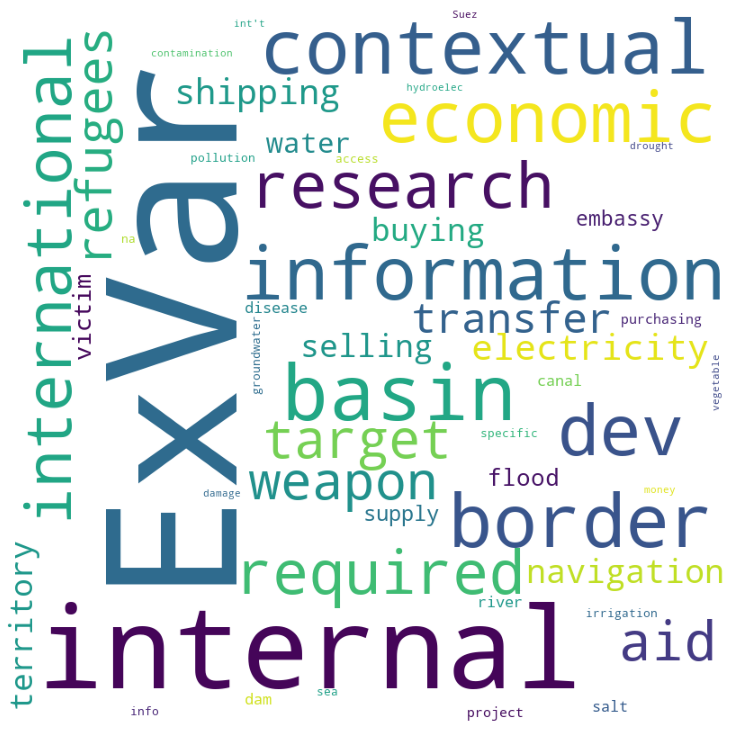

In [37]:
plt.figure(figsize = (10, 10), facecolor = 'None') 
plt.imshow(event_type_wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
  
plt.show()

In [38]:
#lets do the same with event summary (might make more sense)

In [39]:
event_summary_txt=df3_context['EVENT_SUMMARY'].str.cat(sep=', ')
event_summary_txt

'Egypt lays to four foundation stone of Aswan hydroelectric plant, The "Standstill Agreement" between India and Pakistan expires and, in the absence of a new agreement, India discontinues the delivery of water to the Dipalpur Canal and the main branches of the Upper Bari Daab Canal., At an Inter-Dominian conference between India and Pakistan held in Delhi on 3-4 May 1948, India agreed to resume the delivery of water to Pakistan through the Dipalpur Canal and the main branches of the Upper Bari Daab Canal.  India maintained, however, that Pakistan could not claim any share of those waters as a matter of right.  An agreement was signed, later referred to at the Delhi Agreement., Italy and France build dam on Roya River in exchange for ceded land, Austria, Czechoslovakia, Great Britain, France, Hungary, Romania, Yugoslavia (former) United States, and Soviet Union meet for Danube conference on administration of Danube River, Austria, Czechoslovakia, Great Britain, France, Hungary, Romania,

In [40]:
event_summary_wordcloud = WordCloud(width = 800, height = 800, 
                background_color ='white',  
                collocations=False,
                min_font_size = 10).generate(event_summary_txt)

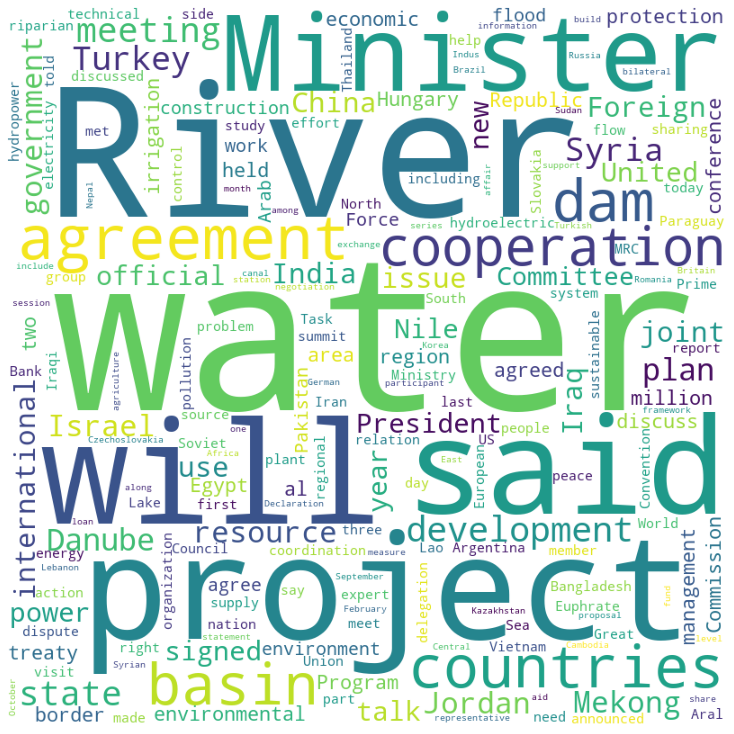

In [41]:
plt.figure(figsize = (10, 10), facecolor = 'None') 
plt.imshow(event_summary_wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
  
plt.show()

In [42]:
#### very pretty but only useful in exploratory analysis (obviously River, Water,Project etc are most freequent)
# core insight: several countries seem to feature prominently in the DB (Isreal, Lebanon , Thailand, Argentina, Turkey, Syria,  India,Egypt)
#
#

In [43]:
#df3 should only be the core info of the db, so which conlfict with whom, where, outcome, what was the issue?

In [44]:
df3=df3.drop(columns=['ID','UNIQUE_ID','Interaction_ID','ID1','EVENT_MASTER', 
                   'GROUPED_ID','BAR_ID','SOURCE_ID', 'DYAD_CODE','LOCATION',
                   'IRM1','IRM2','COPDAB_SCALE','EVENT_TYPE','EVENT_SUMMARY',
                   'Macro_Event','Comments','SOURCE','Source_Source','KLL_Categ',
                   'FBIS_Region','DOC_DATE','EVENT_ISSUE','KLL_ISSUE_NUMBER'
]) 

In [45]:
df3

,DATE,BCode,NUMBER_OF_BASINS,CCODE1,CCODE2,BCCODE1,BCCODE2,COUNTRY_LIST,NUMBER_OF_Countries,BAR_Scale,Issue_Type1,Issue_Type2
0,1948-03-16,NILE,1.0,EGY,INT,NILE_EGY,NILE_INT,Egypt (internal),1.0,3.0,3.0,0.0
1,1948-04-01,INDU,1.0,IND,PAK,INDU_IND,INDU_PAK,India--Pakistan,2.0,-3.0,2.0,0.0
2,1948-05-04,INDU,1.0,IND,PAK,INDU_IND,INDU_PAK,India--Pakistan,2.0,3.0,2.0,0.0
3,1948-07-08,ROIA,1.0,FRA,ITA,ROIA_FRA,ROIA_ITA,France--Italy,2.0,4.0,10.0,0.0
4,1948-07-30,DANU,1.0,CZS,GBR,DANU_CZS,DANU_GBR,Austria--Czechoslovakia--Great Britain--France...,8.0,1.0,8.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...
7123,1980-06-03,GAMB,1.0,GMB,SEN,GAMB_GMB,GAMB_SEN,Gambia --Guinea--Senegal,4.0,1.0,10.0,8.0
7124,1959-06-09,INDU,1.0,IND,PAK,INDU_IND,INDU_PAK,India--Pakistan,2.0,3.0,2.0,0.0
7125,1973-11-05,NTAP,0.0,MLI,INT,NTAP_MLI,NTAP_INT,Mali (internal),2.0,3.0,11.0,0.0
7126,1959-05-05,JORD,1.0,ISR,INT,JORD_ISR,JORD_INT,Israel (internal),1.0,3.0,2.0,10.0


In [46]:
#all tidy, only the essential columns in there

In [47]:
df4.head()

,Entry ID,BCCODE,BCODE,Basin Name,CCODE,Country_Name,2016Update ID,2010_TREATY_DocID,TFDDID,Unified Primary 2016 Treaty ID,Primary2010_Treaty_DocID,PrimaryTFDDID,TFDDID Linkage,DocID Linkage,DocumentName,DateSigned,Signatories,DocType,Format,Source,Notes,LocationSigned,Region_Continent,PRIMARY_COUNTRY_SUBREGION,Treaty Basin(s),TFDD Basin(s),NumberParties,AdditionalComments,MinorAgreement,Reference to Precedence,Agreement Purpose,GeoScope,Issue Area,RBO,Infrastructure,Allocation,Alloc_Article,Alloc_Text,Hydropower,Hydro_Article,Hydropower_Text,Irrigation,Irrigation_Article,Groundwater,Groundwater_Article,Environment,Enviro_Article,Equity_Sustainability,Equity_Article,Equity_Sustainability_Text,LocalNeeds,LocalNeeds_Article,Construct_Right,Construct_Article,Construct_Ban,ConstructBan_Article,PriorNotification,PriorNotif_Article,Navigation,Nav_Article,Fishing,Fish_Article,BorderIssues,Border_Article,TerritorialIssues,Territorial_Article,NonWater Linkage,NonWater_Article,NonWaterLink_Comments,NonWater_Embed,Uncertainty Explicit,UncertExplicit_Article,VarMgmt,VarMgmt_Article,NeedsVariability,NeedsVar_Article,AltScenarios,AltScen_Article,PredictionModel,PredictionModel_Article,JointMgmt,JointMgmt_Article,CommName,TechCoop,TechCoop_Article,InfoExchange,InfoExchange_Article,Monitoring,Monitoring_Article,Conflict Resolution Mechanism,ConflictRes_Article,AgreeFinance,AgreeFinance_Article,StakeholderParticip,Stakeholder_Article,Consultations,Consulations_Article,Compensation,Compensation_Article,National_Prog_Law,NationalLaws_Article,NonSig_Riparians,NonSigInterests_Article,People_Interests,PeoplesInterests_Article,AmendMech,AmendMech_Article,Precedent_NotEst,PrecedentNotEst_Article,Precedent_Est,PrecedentEst_Article,Enforcement,EnforceMech,WaterDiv_Method,Basin_Name
0,1051.0,MEKO_CHN,MEKO,Mekong,CHN,China,623.0,1070,NaN,0.0,NaN,NaN,0,0,Agreement on Providing the Hydrologic Data dur...,2002-04-01 00:00:00,"Cambodia, China, Lao PDR,Thailand, Vietnam",-1,NaN,NaN,"According to the agreement, China will provide...",N.A.,Asia,East Asia,Mekong,Mekong,2,NaN,N.A.,0,0,0,NaN,N.A.,N.A.,-1,NaN,NaN,N.A.,NaN,NaN,N.A.,NaN,N.A.,NaN,-1,NaN,N.A.,NaN,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,0,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,NaN,N.A.,-1,NaN,-1,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,-1,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,N.A.,NaN,N.A.,N.A.,N.A.,Mekong
1,839.0,ILIX_CHN,ILIX,Ili/Kunes He,CHN,China,559.0,614,NaN,0.0,NaN,NaN,0,0,Agreement between the Government of the Republ...,2001-09-12 00:00:00,"China, Kazakhstan",4,Electronic,http://faolex.fao.org/,The Contracting Parties pledge to prevent or m...,"Astana, Kazakhstan",Asia,Central Asia,Frontier or shared waters,"Alakol, Ili/Kunes He, Ob, Tarim",1,NaN,N,5,2,3,Joint Management,Y,N,0,NaN,NaN,N,NaN,NaN,N,NaN,N,NaN,-1,NaN,Y,"Preamble, Article 2","""…Equitably and rationally resolving issue bet...",N,NaN,N,NaN,N,NaN,1,NaN,N,NaN,N,NaN,N,NaN,Y,Preamble,None,NaN,NaN,N,1,Article 5,1,"Article 3, 5",N,NaN,N,NaN,Y,Article 5,Y,Article 8,Kazakhstan-China Joint Commission on the use a...,N,NaN,N,Article 6,N,NaN,2,Article 12,N,NaN,N,NaN,Y,Article 9,N,NaN,N,NaN,N,NaN,N,NaN,Y,Article 13,N,NaN,N,NaN,N,NaN,None,Ili/Kunes He
2,1327.0,OBXX_CHN,OBXX,Ob,CHN,China,559.0,614,NaN,0.0,NaN,NaN,0,0,Agreement between the Government of the Republ...,2001-09-12 00:00:00,"China, Kazakhstan",4,Electronic,http://faolex.fao.org/,The Contracting Parties pledge to prevent or m...,"Astana, Kazakhstan",Asia,Central Asia,Frontier or shared waters,"Alakol, Ili/Kunes He, Ob, Tarim",1,NaN,N,5,2,3,Joint Management,Y,N,0,NaN,NaN,N,NaN,NaN,N,NaN,N,NaN,-1,NaN,Y,"Preamble, Article 2","""…Equitably and rationally resolving issue bet...",N,NaN,N,NaN,N,NaN,1,NaN,N,NaN,N,NaN,N,NaN,Y,Preamble,None,NaN,NaN,N,1,Article 5,1,"Article 3, 5",N,NaN,N,NaN,Y,Article 5,Y,Article 8,Kazakhstan-China Joint Commission on the use a...,N,NaN,N,Article 6,N,NaN,2,Article 12,N,NaN,N,NaN,Y,Articl

In [48]:
df4_deleted=df4[['Entry ID','Basin Name','Country_Name','2016Update ID','2010_TREATY_DocID','TFDDID','Unified Primary 2016 Treaty ID','Primary2010_Treaty_DocID','PrimaryTFDDID','DocID Linkage','Format','Source','LocationSigned','AdditionalComments','MinorAgreement','Reference to Precedence','Hydro_Article','Hydropower_Text','Irrigation_Article','Groundwater_Article','Enviro_Article','Equity_Article','Equity_Sustainability_Text','LocalNeeds_Article','Construct_Article','ConstructBan_Article','PriorNotif_Article','Nav_Article','Fish_Article','Border_Article','Territorial_Article','NonWaterLink_Comments','UncertExplicit_Article','VarMgmt_Article','NeedsVar_Article','AltScen_Article','PredictionModel_Article','JointMgmt_Article','CommName','TechCoop_Article','InfoExchange_Article','Monitoring_Article','ConflictRes_Article','AgreeFinance_Article','Stakeholder_Article','Consulations_Article','Compensation_Article','NationalLaws_Article','NonSigInterests_Article','PeoplesInterests_Article','AmendMech_Article','PrecedentNotEst_Article','PrecedentEst_Article','Basin_Name']]

In [49]:
df4=df4.drop(columns=['Entry ID','Basin Name','Country_Name','2016Update ID','2010_TREATY_DocID','TFDDID','Unified Primary 2016 Treaty ID','Primary2010_Treaty_DocID','PrimaryTFDDID','DocID Linkage','Format','Source','LocationSigned','AdditionalComments','MinorAgreement','Reference to Precedence','Hydro_Article','Hydropower_Text','Irrigation_Article','Groundwater_Article','Enviro_Article','Equity_Article','Equity_Sustainability_Text','LocalNeeds_Article','Construct_Article','ConstructBan_Article','PriorNotif_Article','Nav_Article','Fish_Article','Border_Article','Territorial_Article','NonWaterLink_Comments','UncertExplicit_Article','VarMgmt_Article','NeedsVar_Article','AltScen_Article','PredictionModel_Article','JointMgmt_Article','CommName','TechCoop_Article','InfoExchange_Article','Monitoring_Article','ConflictRes_Article','AgreeFinance_Article','Stakeholder_Article','Consulations_Article','Compensation_Article','NationalLaws_Article','NonSigInterests_Article','PeoplesInterests_Article','AmendMech_Article','PrecedentNotEst_Article','PrecedentEst_Article','WaterDiv_Method','Basin_Name'])

In [50]:
df4_deleted.shape

(2118, 54)

In [51]:
df4.shape

(2118, 60)

In [52]:
df4.columns

Index(['BCCODE', 'BCODE', 'CCODE', ' TFDDID Linkage', 'DocumentName',
       'DateSigned', 'Signatories', 'DocType', 'Notes', 'Region_Continent',
       'PRIMARY_COUNTRY_SUBREGION', 'Treaty Basin(s)', 'TFDD Basin(s)',
       'NumberParties', 'Agreement Purpose', 'GeoScope', 'Issue Area', 'RBO',
       'Infrastructure', 'Allocation', 'Alloc_Article', 'Alloc_Text',
       'Hydropower', 'Irrigation', 'Groundwater', 'Environment',
       'Equity_Sustainability', 'LocalNeeds', 'Construct_Right',
       'Construct_Ban', 'PriorNotification', 'Navigation', 'Fishing',
       'BorderIssues', 'TerritorialIssues', 'NonWater Linkage',
       'NonWater_Article', 'NonWater_Embed', 'Uncertainty Explicit', 'VarMgmt',
       'NeedsVariability', 'AltScenarios', 'PredictionModel', 'JointMgmt',
       'TechCoop', 'InfoExchange', 'Monitoring',
       'Conflict Resolution Mechanism', 'AgreeFinance', 'StakeholderParticip',
       'Consultations', 'Compensation', 'National_Prog_Law',
       'NonSig_Riparians',

In [53]:
# lets do a wordcloud for 'Notes'

In [54]:
treaty_notes=df4['Notes'].str.cat(sep=', ')
treaty_notes

'According to the agreement, China will provide hydrologic information to the other four downstream riparian countries., The Contracting Parties pledge to prevent or mitigate the consequences of flooding (art. 2). The Contracting Parties have agreed to cooperate in the following fields: (a) measurement of water quantity and assessment of water quality standards; (b) prevent, The Contracting Parties pledge to prevent or mitigate the consequences of flooding (art. 2). The Contracting Parties have agreed to cooperate in the following fields: (a) measurement of water quantity and assessment of water quality standards; (b) prevent, Agreement applies to Ussuri, Amur [border-creator but enters state], and Argun [partial border-creator] Rivers, Focused on border issues but has provision that Peru will provide some Ecuadorian villages cut off from their water supplies with water, Focused on border issues but has provision that Peru will provide some Ecuadorian villages cut off from their water 

In [55]:
treaty_notes = WordCloud(width = 800, height = 800, 
                background_color ='white',  
                collocations=False,
                min_font_size = 10).generate(treaty_notes)

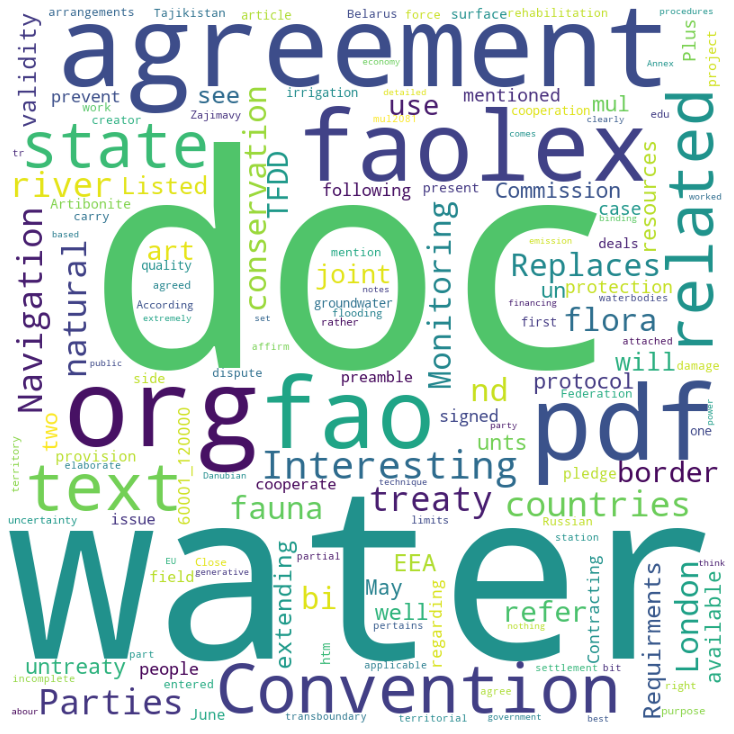

In [56]:
plt.figure(figsize = (10, 10), facecolor = 'None') 
plt.imshow(treaty_notes) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
  
plt.show()

In [57]:
df2.shape

(812, 20)

In [58]:
df3.shape

(7128, 12)

In [59]:
df4_count=df4[['BCCODE','DateSigned']]

In [60]:
treaties=df4_count.groupby(['BCCODE']).count()

In [61]:
# get the amount of treaties per BCCODE

In [62]:
treaties

,DateSigned
BCCODE,
ALKL_KAZ,1
AMUR_CHN,4
AMUR_MNG,2
AMUR_RUS,4
AMZN_BOL,3
...,...
ZAMB_TZA,2
ZAMB_ZMB,7
ZAMB_ZWE,5


In [63]:
treaties=treaties.rename(columns={"DateSigned": "number of treaties"})

In [64]:
treaties

,number of treaties
BCCODE,
ALKL_KAZ,1
AMUR_CHN,4
AMUR_MNG,2
AMUR_RUS,4
AMZN_BOL,3
...,...
ZAMB_TZA,2
ZAMB_ZMB,7
ZAMB_ZWE,5


In [65]:
#lets try merging df2 (basins info) and df3 (conflicts) and whether a treaty exists based on key basin code (BCODE) 

In [66]:
df3_1=pd.merge(df3,df2,how='left',left_on=['BCCODE1'],right_on=['BCCODE'])

In [67]:
df5=pd.merge(df3_1,treaties,how='left',left_on='BCCODE1',right_on=['BCCODE'])

In [68]:
df5.shape

(7128, 33)

In [69]:
df5

,DATE,BCode,NUMBER_OF_BASINS,CCODE1,CCODE2,BCCODE1,BCCODE2,COUNTRY_LIST,NUMBER_OF_Countries,BAR_Scale,Issue_Type1,Issue_Type2,BCCODE,Basin_Name,Continent_,Area_km2,Pop_2015,PopDen2015,Pop_2007,PopDen2007,Pop_2020,PopDen2020,Pop_2012_P,PopDen12_P,Dams_Exist,Dam_Plnd,runoff,withdrawal,consumpt,HydroPolTe,InstitVuln,geometry,number of treaties
0,1948-03-16,NILE,1.0,EGY,INT,NILE_EGY,NILE_INT,Egypt (internal),1.0,3.0,3.0,0.0,NILE_EGY,Nile,AF,236413.0,98510782.0,417.0,73921273.0,313.0,108212375.0,458.0,102149969.0,432.0,4.0,0.0,0.513438425,54067.965,31694.409,3,5,"MULTIPOLYGON (((3871673.487 2424768.036, 38618...",11.0
1,1948-04-01,INDU,1.0,IND,PAK,INDU_IND,INDU_PAK,India--Pakistan,2.0,-3.0,2.0,0.0,INDU_IND,Indus,AS,78781.0,29389861.0,373.0,23520813.0,299.0,30421452.0,386.0,31393385.0,398.0,4.0,24.0,529.7819266,35927.283,12814.736,3,5,"MULTIPOLYGON (((8727350.117 3410395.737, 87278...",9.0
2,1948-05-04,INDU,1.0,IND,PAK,INDU_IND,INDU_PAK,India--Pakistan,2.0,3.0,2.0,0.0,INDU_IND,Indus,AS,78781.0,29389861.0,373.0,23520813.0,299.0,30421452.0,386.0,31393385.0,398.0,4.0,24.0,529.7819266,35927.283,12814.736,3,5,"MULTIPOLYGON (((8727350.117 3410395.737, 87278...",9.0
3,1948-07-08,ROIA,1.0,FRA,ITA,ROIA_FRA,ROIA_ITA,France--Italy,2.0,4.0,10.0,0.0,ROIA_FRA,Roia,EU,593.0,9944.0,17.0,3509.0,6.0,10416.0,18.0,4587.0,8.0,0.0,0.0,0,0,0,2,3,"MULTIPOLYGON (((836320.459 4396209.334, 836627...",2.0
4,1948-07-30,DANU,1.0,CZS,GBR,DANU_CZS,DANU_GBR,Austria--Czechoslovakia--Great Britain--France...,8.0,1.0,8.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7123,1980-06-03,GAMB,1.0,GMB,SEN,GAMB_GMB,GAMB_SEN,Gambia --Guinea--Senegal,4.0,1.0,10.0,8.0,GAMB_GMB,Gambia,AF,9859.0,1947290.0,198.0,1414084.0,143.0,2199812.0,223.0,2240162.0,227.0,0.0,0.0,32.10584481,24.926,7.64,1,4,"POLYGON ((-1764439.125 1443453.043, -1764483.3...",7.0
7124,1959-06-09,INDU,1.0,IND,PAK,INDU_IND,INDU_PAK,India--Pakistan,2.0,3.0,2.0,0.0,INDU_IND,Indus,AS,78781.0,29389861.0,373.0,23520813.0,299.0,30421452.0,386.0,31393385.0,398.0,4.0,24.0,529.7819266,35927.283,12814.736,3,5,"MULTIPOLYGON (((8727350.117 3410395.737, 87278...",9.0
7125,1973-11-05,NTAP,0.0,MLI,INT,NTAP_MLI,NTAP_INT,Mali (internal),2.0,3.0,11.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,NaN
7126,1959-05-05,JORD,1.0,ISR,INT,JORD_ISR,JORD_INT,Israel (internal),1.0,3.0,2.0,10.0,JORD_ISR,Jordan,AS,9626.0,740141.0,77.0,466325.0,48.0,790423.0,82.0,709766.0,74.0,0.0,0.0,137.0882893,639.325,310.16,1,5,"MULTIPOLYGON (((3965695.077 3477637.173, 39660...",9.0


In [70]:
# lets get the ratio of population to consumption

In [71]:
#lets get reduce the date to year

In [72]:
df5['year'] = df5['DATE'].astype(str).str[:4]

In [73]:
df5=df5.drop(columns=['DATE'])

In [74]:
#group by outcome of conflict and look at average hydropolitical tension factor and institutional vulnability

In [75]:
df5[["runoff", "withdrawal",'consumpt','HydroPolTe','InstitVuln','number of treaties']] = df5[["runoff", "withdrawal",'consumpt','HydroPolTe','InstitVuln','number of treaties']].apply(pd.to_numeric)

In [76]:
df5_count=df5[['BAR_Scale','NUMBER_OF_Countries','HydroPolTe','InstitVuln','Issue_Type1','number of treaties','PopDen2007','withdrawal','Dams_Exist']]

In [77]:
df5_count.groupby(['BAR_Scale']).count()

,NUMBER_OF_Countries,HydroPolTe,InstitVuln,Issue_Type1,number of treaties,PopDen2007,withdrawal,Dams_Exist
BAR_Scale,,,,,,,,
-7.0,4,1,1,4,1,1,1,1
-6.0,31,27,27,31,27,27,27,27
-5.0,43,27,27,43,26,27,27,27
-4.0,18,8,8,18,11,8,8,8
-3.0,121,90,90,121,94,90,90,90
-2.0,363,290,290,363,284,290,290,290
-1.0,632,614,614,721,596,614,614,614
0.0,255,212,212,272,195,212,212,212
1.0,1650,1485,1485,1889,1478,1485,1485,1485


In [78]:
df5_count.groupby(['BAR_Scale']).mean()

,NUMBER_OF_Countries,HydroPolTe,InstitVuln,Issue_Type1,number of treaties,PopDen2007,withdrawal,Dams_Exist
BAR_Scale,,,,,,,,
-7.0,2.000000,3.000000,0.000000,4.250000,3.000000,83.000000,542.903000,9.000000
-6.0,2.000000,1.851852,4.185185,3.419355,7.666667,86.259259,23098.227333,4.000000
-5.0,2.046512,2.037037,4.444444,4.139535,7.807692,119.333333,42456.186444,8.296296
-4.0,2.000000,2.375000,4.750000,3.500000,7.000000,195.375000,18643.951500,3.875000
-3.0,2.371901,2.422222,4.188889,5.066116,8.553191,193.411111,27407.205489,8.144444
-2.0,2.355372,2.462069,4.165517,5.206612,8.179577,175.382759,31256.497810,6.665517
-1.0,2.873418,2.589577,4.200326,4.778086,8.500000,172.902280,25847.983917,7.796417
0.0,3.552941,2.622642,3.910377,4.713235,8.825641,196.014151,24172.521198,7.735849
1.0,4.813333,2.674747,4.264646,5.645315,8.141407,163.624916,23270.384226,7.707071


In [79]:
correlation=df5_count.corr()

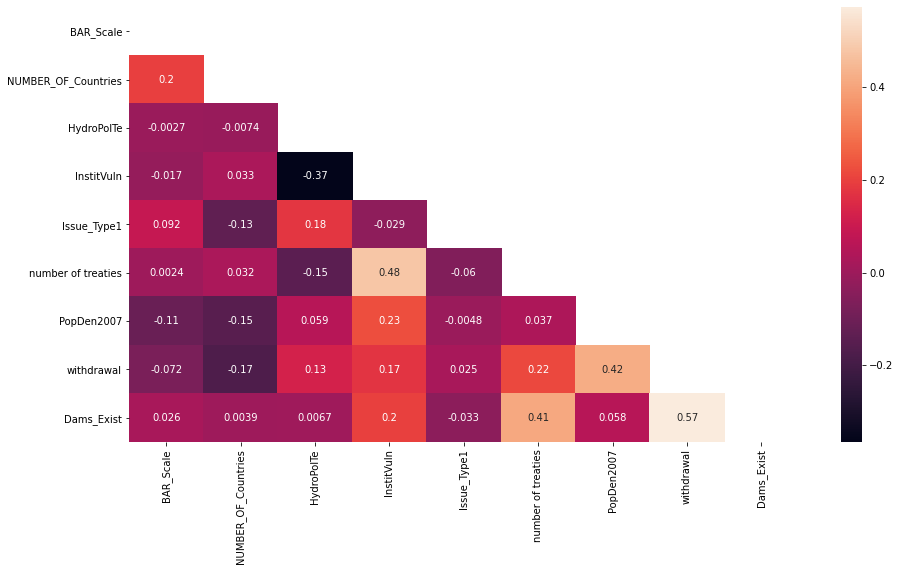

In [80]:
plt.figure(figsize=(15,8))
mask = np.zeros_like(correlation)
mask[np.triu_indices_from(mask)] = True
sns.heatmap(correlation, annot=True, mask=mask)

In [81]:
#no high correlation --no single good predictor of outcome 
#consumption and withdrawel is almost the same

In [82]:
corrMatr=df5.corr()

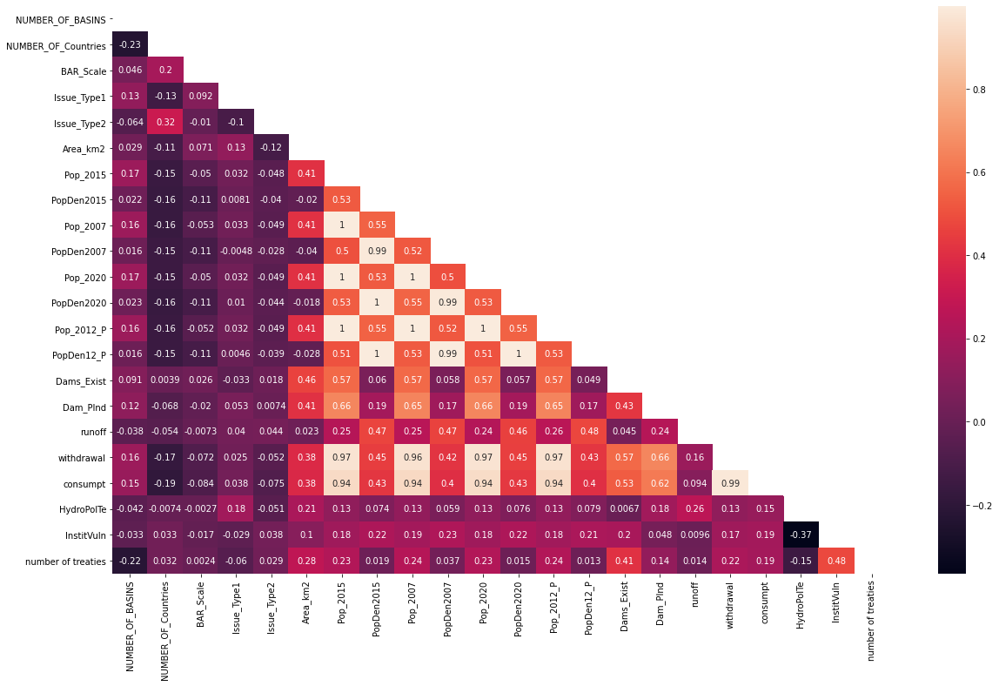

In [83]:
plt.figure(figsize=(20,12))
mask = np.zeros_like(corrMatr)
mask[np.triu_indices_from(mask)] = True
sns.heatmap(corrMatr, annot=True,mask=mask)

In [84]:
# no high correlation between a single independet variable and the dependent (barscale)



In [85]:
df5.head()

,BCode,NUMBER_OF_BASINS,CCODE1,CCODE2,BCCODE1,BCCODE2,COUNTRY_LIST,NUMBER_OF_Countries,BAR_Scale,Issue_Type1,Issue_Type2,BCCODE,Basin_Name,Continent_,Area_km2,Pop_2015,PopDen2015,Pop_2007,PopDen2007,Pop_2020,PopDen2020,Pop_2012_P,PopDen12_P,Dams_Exist,Dam_Plnd,runoff,withdrawal,consumpt,HydroPolTe,InstitVuln,geometry,number of treaties,year
0,NILE,1.0,EGY,INT,NILE_EGY,NILE_INT,Egypt (internal),1.0,3.0,3.0,0.0,NILE_EGY,Nile,AF,236413.0,98510782.0,417.0,73921273.0,313.0,108212375.0,458.0,102149969.0,432.0,4.0,0.0,0.513438,54067.965,31694.409,3.0,5.0,"MULTIPOLYGON (((3871673.487 2424768.036, 38618...",11.0,1948
1,INDU,1.0,IND,PAK,INDU_IND,INDU_PAK,India--Pakistan,2.0,-3.0,2.0,0.0,INDU_IND,Indus,AS,78781.0,29389861.0,373.0,23520813.0,299.0,30421452.0,386.0,31393385.0,398.0,4.0,24.0,529.781927,35927.283,12814.736,3.0,5.0,"MULTIPOLYGON (((8727350.117 3410395.737, 87278...",9.0,1948
2,INDU,1.0,IND,PAK,INDU_IND,INDU_PAK,India--Pakistan,2.0,3.0,2.0,0.0,INDU_IND,Indus,AS,78781.0,29389861.0,373.0,23520813.0,299.0,30421452.0,386.0,31393385.0,398.0,4.0,24.0,529.781927,35927.283,12814.736,3.0,5.0,"MULTIPOLYGON (((8727350.117 3410395.737, 87278...",9.0,1948
3,ROIA,1.0,FRA,ITA,ROIA_FRA,ROIA_ITA,France--Italy,2.0,4.0,10.0,0.0,ROIA_FRA,Roia,EU,593.0,9944.0,17.0,3509.0,6.0,10416.0,18.0,4587.0,8.0,0.0,0.0,0.000000,0.000,0.000,2.0,3.0,"MULTIPOLYGON (((836320.459 4396209.334, 836627...",2.0,1948
4,DANU,1.0,CZS,GBR,DANU_CZS,DANU_GBR,Austria--Czechoslovakia--Great Britain--France...,8.0,1.0,8.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,NaN,1948


In [86]:
#drop some final columns

In [87]:
df5=df5.drop(columns=['BCode','CCODE1','CCODE2','PopDen2015'])

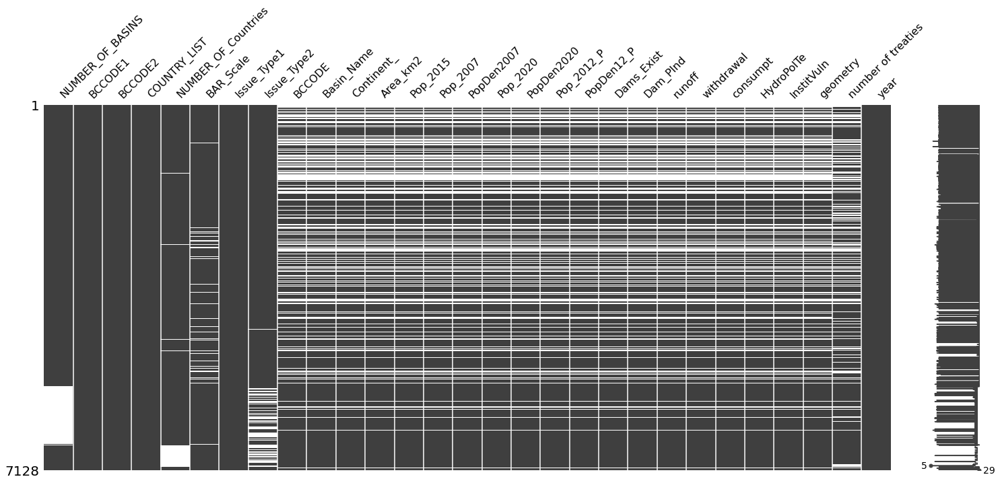

In [88]:
msno.matrix(df5)

In [89]:
df5.shape

(7128, 29)

In [90]:
####MAIN ANALYSIS####

In [91]:
#drop geometry for a sec since it doesnt work for the profile report
df5_report=df5.drop(columns=['geometry'])

In [92]:
from pandas_profiling import ProfileReport

In [93]:
ProfileReport(df5_report,explorative=True)

In [94]:
##### conclusions pandas profiling report:

#               Duplicates: duplicates are classified based on date (but several conflict have happened ag similiar dates, see 1951 01 01)
#               Missing Values: a lot of missing values but a lot of times this is not something that can be extrapolated, for example c codes)
#               Bar_scale is the primary output, so all missing rows should be deleted (4.5%)
#               a lot of values are missing exactly 1595 (23.4%) --> missmatch between data frames
#               EITHER: delete where missmatch occurs(df5) OR: keep and hope it works out(df6)
#               Replace Number of basins missing values (20%) with 1 (since all are related to at least one)
#               drop issue type 2 because it only focuses on side issues, not the main conflict issue
#

In [95]:
df5.isna().sum()

NUMBER_OF_BASINS       1132
BCCODE1                   0
BCCODE2                   0
COUNTRY_LIST              6
NUMBER_OF_Countries     434
BAR_Scale               323
Issue_Type1               1
Issue_Type2             705
BCCODE                 1770
Basin_Name             1770
Continent_             1770
Area_km2               1770
Pop_2015               1770
Pop_2007               1770
PopDen2007             1770
Pop_2020               1770
PopDen2020             1770
Pop_2012_P             1770
PopDen12_P             1770
Dams_Exist             1770
Dam_Plnd               1770
runoff                 1770
withdrawal             1770
consumpt               1770
HydroPolTe             1770
InstitVuln             1770
geometry               1770
number of treaties     1722
year                      0
dtype: int64

In [96]:
df5.groupby(['NUMBER_OF_BASINS']).count()

,BCCODE1,BCCODE2,COUNTRY_LIST,NUMBER_OF_Countries,BAR_Scale,Issue_Type1,Issue_Type2,BCCODE,Basin_Name,Continent_,Area_km2,Pop_2015,Pop_2007,PopDen2007,Pop_2020,PopDen2020,Pop_2012_P,PopDen12_P,Dams_Exist,Dam_Plnd,runoff,withdrawal,consumpt,HydroPolTe,InstitVuln,geometry,number of treaties,year
NUMBER_OF_BASINS,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0.0,268,268,268,266,204,268,268,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,268
1.0,4469,4469,4464,4044,4289,4468,4251,3839,3839,3839,3839,3839,3839,3839,3839,3839,3839,3839,3839,3839,3839,3839,3839,3839,3839,3839,3720,4469
2.0,124,124,124,122,116,124,122,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,71,124
3.0,93,93,93,93,90,93,93,80,80,80,80,80,80,80,80,80,80,80,80,80,80,80,80,80,80,80,72,93
4.0,72,72,72,72,68,72,68,71,71,71,71,71,71,71,71,71,71,71,71,71,71,71,71,71,71,71,42,72
5.0,45,45,45,45,40,45,45,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,43,45
6.0,12,12,12,12,6,12,12,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,8,12
14.0,74,74,74,74,74,74,74,71,71,71,71,71,71,71,71,71,71,71,71,71,71,71,71,71,71,71,64,74
16.0,45,45,45,45,45,45,45,45,45,45,45,45,45,45,45,45,45,45,45,45,45,45,45,45,45,45,40,45


In [97]:
#replace missing ones # of basins with 1

In [98]:
df5['NUMBER_OF_BASINS'] = df5['NUMBER_OF_BASINS'].fillna(1)

In [99]:
#get rid of all rows which do not have bar scale or hydropolten

In [100]:
df5 = df5[df5['BAR_Scale'].notna()]

In [101]:
df5.isna().sum()

NUMBER_OF_BASINS          0
BCCODE1                   0
BCCODE2                   0
COUNTRY_LIST              4
NUMBER_OF_Countries     428
BAR_Scale                 0
Issue_Type1               1
Issue_Type2             705
BCCODE                 1595
Basin_Name             1595
Continent_             1595
Area_km2               1595
Pop_2015               1595
Pop_2007               1595
PopDen2007             1595
Pop_2020               1595
PopDen2020             1595
Pop_2012_P             1595
PopDen12_P             1595
Dams_Exist             1595
Dam_Plnd               1595
runoff                 1595
withdrawal             1595
consumpt               1595
HydroPolTe             1595
InstitVuln             1595
geometry               1595
number of treaties     1561
year                      0
dtype: int64

In [102]:
#fill countries 

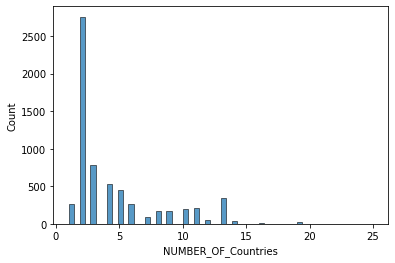

In [103]:
sns.histplot(data=df5['NUMBER_OF_Countries'])

In [104]:
df5.groupby(['NUMBER_OF_Countries']).count()

,NUMBER_OF_BASINS,BCCODE1,BCCODE2,COUNTRY_LIST,BAR_Scale,Issue_Type1,Issue_Type2,BCCODE,Basin_Name,Continent_,Area_km2,Pop_2015,Pop_2007,PopDen2007,Pop_2020,PopDen2020,Pop_2012_P,PopDen12_P,Dams_Exist,Dam_Plnd,runoff,withdrawal,consumpt,HydroPolTe,InstitVuln,geometry,number of treaties,year
NUMBER_OF_Countries,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1.0,261,261,261,261,261,261,261,107,107,107,107,107,107,107,107,107,107,107,107,107,107,107,107,107,107,107,119,261
2.0,2758,2758,2758,2758,2758,2758,2464,2066,2066,2066,2066,2066,2066,2066,2066,2066,2066,2066,2066,2066,2066,2066,2066,2066,2066,2066,2149,2758
3.0,789,789,789,788,789,789,739,564,564,564,564,564,564,564,564,564,564,564,564,564,564,564,564,564,564,564,577,789
4.0,527,527,527,527,527,527,501,430,430,430,430,430,430,430,430,430,430,430,430,430,430,430,430,430,430,430,421,527
5.0,447,447,447,447,447,447,410,385,385,385,385,385,385,385,385,385,385,385,385,385,385,385,385,385,385,385,391,447
6.0,259,259,259,259,259,259,253,209,209,209,209,209,209,209,209,209,209,209,209,209,209,209,209,209,209,209,209,259
7.0,97,97,97,97,97,97,67,55,55,55,55,55,55,55,55,55,55,55,55,55,55,55,55,55,55,55,54,97
8.0,172,172,172,172,172,172,172,106,106,106,106,106,106,106,106,106,106,106,106,106,106,106,106,106,106,106,107,172
9.0,172,172,172,172,172,172,172,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,172


In [105]:
#choose most frequent (2)

In [106]:
df5['NUMBER_OF_Countries'] = df5['NUMBER_OF_Countries'].fillna(2)

In [107]:
df5.isna().sum()

NUMBER_OF_BASINS          0
BCCODE1                   0
BCCODE2                   0
COUNTRY_LIST              4
NUMBER_OF_Countries       0
BAR_Scale                 0
Issue_Type1               1
Issue_Type2             705
BCCODE                 1595
Basin_Name             1595
Continent_             1595
Area_km2               1595
Pop_2015               1595
Pop_2007               1595
PopDen2007             1595
Pop_2020               1595
PopDen2020             1595
Pop_2012_P             1595
PopDen12_P             1595
Dams_Exist             1595
Dam_Plnd               1595
runoff                 1595
withdrawal             1595
consumpt               1595
HydroPolTe             1595
InstitVuln             1595
geometry               1595
number of treaties     1561
year                      0
dtype: int64

In [108]:
# so either delete 1595 values or keep them --> I decided to delete and store in new df

In [109]:
df6 = df5[df5['InstitVuln'].notna()]

In [110]:
df6.isna().sum()

NUMBER_OF_BASINS         0
BCCODE1                  0
BCCODE2                  0
COUNTRY_LIST             0
NUMBER_OF_Countries      0
BAR_Scale                0
Issue_Type1              0
Issue_Type2            675
BCCODE                   0
Basin_Name               0
Continent_               0
Area_km2                 0
Pop_2015                 0
Pop_2007                 0
PopDen2007               0
Pop_2020                 0
PopDen2020               0
Pop_2012_P               0
PopDen12_P               0
Dams_Exist               0
Dam_Plnd                 0
runoff                   0
withdrawal               0
consumpt                 0
HydroPolTe               0
InstitVuln               0
geometry                 0
number of treaties     219
year                     0
dtype: int64

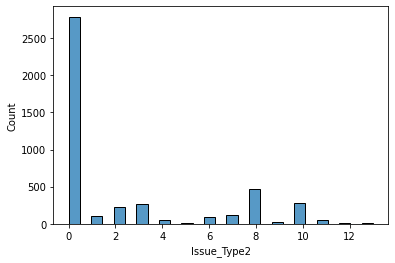

In [111]:

sns.histplot(data=df6['Issue_Type2'])

In [112]:
#replace with 0, its also just the subtype issue so not as important as issue type 1
df6['Issue_Type2'] = df6['Issue_Type2'].fillna(0)

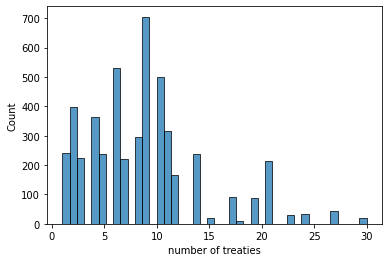

In [113]:
sns.histplot(data=df6['number of treaties'])

In [114]:
#replace with 0 since most likely no treaties exist

In [115]:
df6['number of treaties'] = df6['number of treaties'].fillna(0)

In [116]:
df6.isna().sum()

NUMBER_OF_BASINS       0
BCCODE1                0
BCCODE2                0
COUNTRY_LIST           0
NUMBER_OF_Countries    0
BAR_Scale              0
Issue_Type1            0
Issue_Type2            0
BCCODE                 0
Basin_Name             0
Continent_             0
Area_km2               0
Pop_2015               0
Pop_2007               0
PopDen2007             0
Pop_2020               0
PopDen2020             0
Pop_2012_P             0
PopDen12_P             0
Dams_Exist             0
Dam_Plnd               0
runoff                 0
withdrawal             0
consumpt               0
HydroPolTe             0
InstitVuln             0
geometry               0
number of treaties     0
year                   0
dtype: int64

In [117]:
# no NaNs --> good. lets check the report again and check dtypes

In [118]:
df6.dtypes

NUMBER_OF_BASINS        float64
BCCODE1                  object
BCCODE2                  object
COUNTRY_LIST             object
NUMBER_OF_Countries     float64
BAR_Scale               float64
Issue_Type1             float64
Issue_Type2             float64
BCCODE                   object
Basin_Name               object
Continent_               object
Area_km2                float64
Pop_2015                float64
Pop_2007                float64
PopDen2007              float64
Pop_2020                float64
PopDen2020              float64
Pop_2012_P              float64
PopDen12_P              float64
Dams_Exist              float64
Dam_Plnd                float64
runoff                  float64
withdrawal              float64
consumpt                float64
HydroPolTe              float64
InstitVuln              float64
geometry               geometry
number of treaties      float64
year                     object
dtype: object

In [119]:
df6['year'].value_counts()

2004    298
1996    290
1999    283
1992    274
1995    267
       ... 
1970     15
NaT      14
1949      9
1950      9
1971      7
Name: year, Length: 62, dtype: int64

In [120]:
# for some reason there is a NaT in there... only 14 though so lets just drop it

In [121]:
df6 = df6[df6.year != 'NaT']

In [122]:
df6['year'].value_counts()

2004    298
1996    290
1999    283
1992    274
1995    267
       ... 
1979     15
1970     15
1950      9
1949      9
1971      7
Name: year, Length: 61, dtype: int64

In [123]:
df6['year'] = df6['year'].apply(pd.to_numeric)

In [124]:
df6.dtypes

NUMBER_OF_BASINS        float64
BCCODE1                  object
BCCODE2                  object
COUNTRY_LIST             object
NUMBER_OF_Countries     float64
BAR_Scale               float64
Issue_Type1             float64
Issue_Type2             float64
BCCODE                   object
Basin_Name               object
Continent_               object
Area_km2                float64
Pop_2015                float64
Pop_2007                float64
PopDen2007              float64
Pop_2020                float64
PopDen2020              float64
Pop_2012_P              float64
PopDen12_P              float64
Dams_Exist              float64
Dam_Plnd                float64
runoff                  float64
withdrawal              float64
consumpt                float64
HydroPolTe              float64
InstitVuln              float64
geometry               geometry
number of treaties      float64
year                      int64
dtype: object

In [125]:
df6_report = df6.drop(columns=['geometry'])

In [126]:
ProfileReport(df6_report,explorative=True)

In [127]:
#drop highly correlated values (either consumpt or withdrawel) 

In [ ]:
#finished with cleaning and getting the data ready for ML
#but lets do analysis first

In [ ]:
sns.barplot(data=df6, x="BAR_Scale", y="Issue_Type1")
sns.catplot(data=df6, x='BAR_Scale',y='Issue_Type1')


In [ ]:
sns.catplot(data=df6,y='InstitVuln',x='Continent_')

In [ ]:
sns.catplot(data=df6, x='BAR_Scale',y='HydroPolTe')


In [ ]:
sns.catplot(data=df6, x='BAR_Scale',y='InstitVuln')


In [ ]:
sns.catplot(data=df6,y='Dams_Exist',x='HydroPolTe')


In [ ]:
df6.columns

In [ ]:
sns.lineplot(x="year", y="number of treaties",
             data=df6)


In [187]:
df6_treaty=df6[['year','number of treaties']]
df6_2=df6_treaty.groupby(['year'],as_index=False).sum()


In [188]:
df6_2

,year,number of treaties
0,1948,241.0
1,1949,85.0
2,1950,59.0
3,1951,194.0
4,1952,215.0
...,...,...
56,2004,2605.0
57,2005,2284.0
58,2006,662.0
59,2007,881.0


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

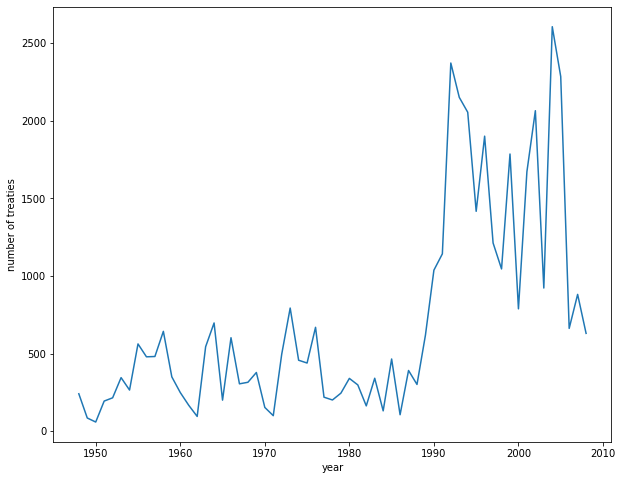

In [189]:
plt.figure(figsize=(10,8))
sns.lineplot(data=df6_2, x='year',y='number of treaties')
#plt.savefig("treates_time.png",dpi=300, transparent=True)
#files.download("treates_time.png") 

In [ ]:
#so collaboration has increased over time

In [ ]:
#ISSUE TYPE

In [ ]:
sns.histplot(data=df3,x='Issue_Type1')

In [ ]:
sns.lineplot(x="year", y="Issue_Type1",
             data=df6)
#doesnt make sense, we want issue type by year

In [ ]:
df6_issue=df6[['year','Issue_Type1','NUMBER_OF_BASINS']]
df6_1=df6_issue.groupby(['year','Issue_Type1'], as_index=False).count()
df6_1.rename(columns={"NUMBER_OF_BASINS": "count(issue_type)"}, inplace=True)


In [ ]:
df6_1

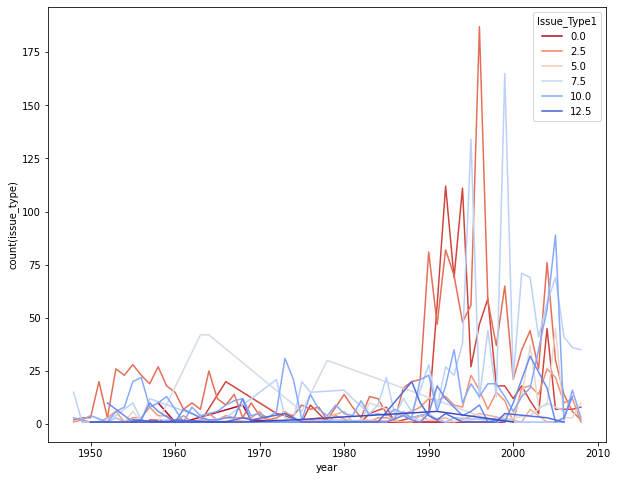

In [172]:
plt.figure(figsize=(10,8))
sns.lineplot(data=df6_1, x='year',y='count(issue_type)',palette='coolwarm_r', hue='Issue_Type1')


In [171]:
df6_issue=df6[['Issue_Type1','NUMBER_OF_BASINS']]
df6_1_1=df6_issue.groupby(['Issue_Type1'], as_index=False).count()
df6_1_1.rename(columns={"NUMBER_OF_BASINS": "count"}, inplace=True)
df6_1_1.rename(columns={"Issue_Type1": "Issue_Type"}, inplace=True)

df6_1_1

,Issue_Type,count
0,0.0,29
1,1.0,702
2,2.0,1451
3,3.0,371
4,4.0,48
5,5.0,6
6,6.0,182
7,7.0,145
8,8.0,1157
9,9.0,54


In [ ]:
issue_file=pd.read_excel('/content/drive/MyDrive/Colab Notebooks/issuetype.xlsx')

In [ ]:
issue_file.columns

In [ ]:
issue_file=issue_file.rename(columns={'Description of Issue Areas*':'Description'})

In [ ]:
issue_dict= dict(zip(issue_file.Issue_Type1,issue_file.Description))

In [ ]:
issue_dict

In [ ]:
df6_1_1=df6_1_1.replace({"Issue_Type": issue_dict})



In [ ]:
df6_1_1

In [ ]:
df6_1_1=df6_1_1.drop(0)

In [ ]:
labels =df6_1_1['Issue_Type']
df6_1_1.plot.pie(y='count',labels=labels)

<function matplotlib.pyplot.show>

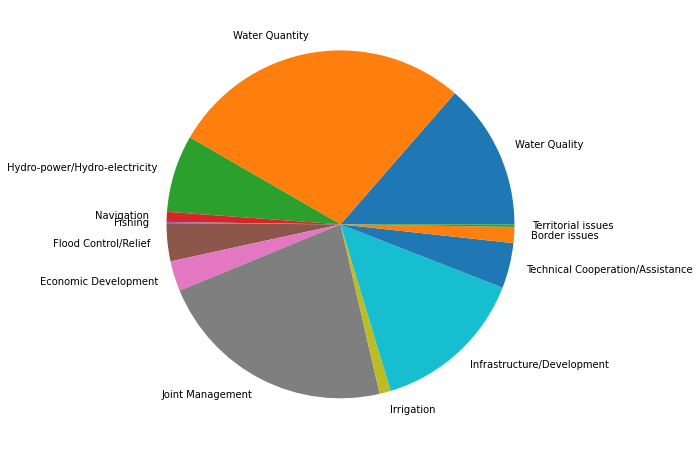

In [170]:
plt.figure(figsize=(10,8))
y=df6_1_1['count']
labels =df6_1_1['Issue_Type']
plt.pie(y,labels=labels)
plt.show

In [ ]:
y=df6_1_1['count']
labels =df6_1_1['Issue_Type']
sns.barplot(y='y',x='labels')

In [ ]:
#BAR SCALE

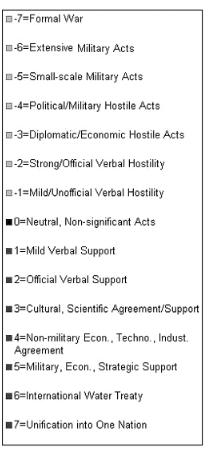

In [158]:
# -7 most violent (formal declaration of war), +7 = voluntary unification into one nation 
from IPython.display import Image


Image("/content/drive/MyDrive/Colab Notebooks/conflict scale.png")


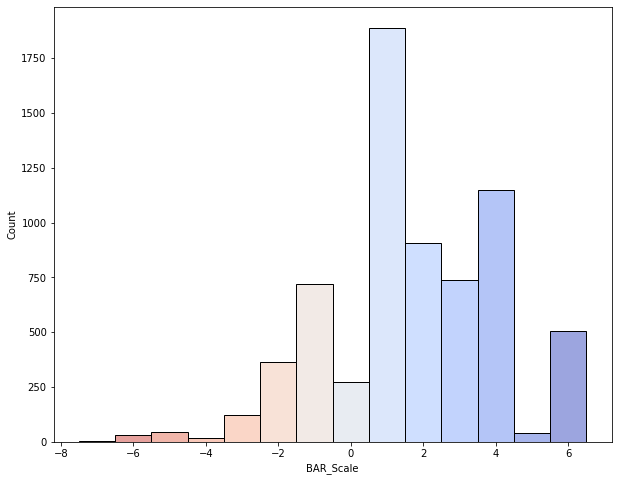

In [159]:
plt.figure(figsize=(10,8))
sns.histplot(data=df3,x='BAR_Scale',binwidth=1,hue='BAR_Scale',palette='coolwarm_r',legend=False, discrete=True)
plt.savefig('conflict&cooperation.png',dpi=300,transparent=True)



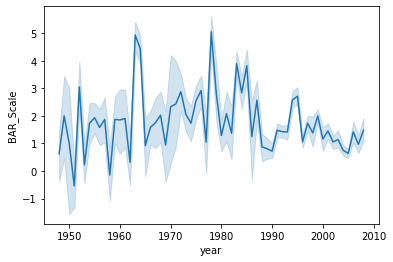

In [160]:
sns.lineplot(data=df6, x='year',y='BAR_Scale')

In [161]:
df6_bar=df6[['year','BAR_Scale','NUMBER_OF_BASINS']]
df6_3=df6_bar.groupby(['year','BAR_Scale'], as_index=False).count()
df6_3.rename(columns={"NUMBER_OF_BASINS": "count(BAR_Scale)"}, inplace=True)
df6_3

,year,BAR_Scale,count(BAR_Scale)
0,1948,-6.0,1
1,1948,-3.0,2
2,1948,1.0,15
3,1948,3.0,2
4,1948,4.0,1
...,...,...,...
486,2008,1.0,28
487,2008,2.0,7
488,2008,3.0,7
489,2008,4.0,7


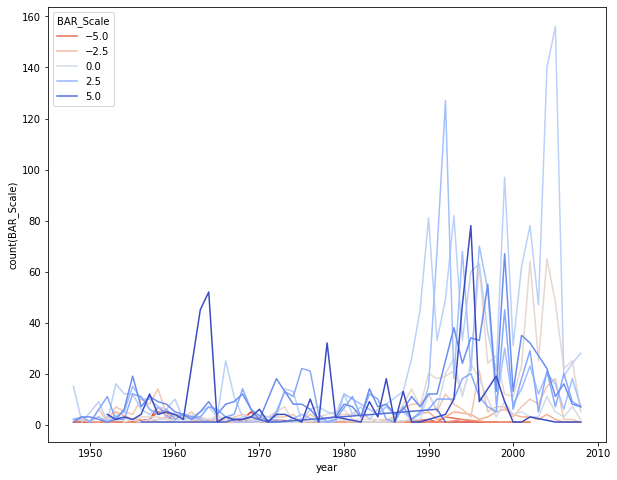

In [162]:
plt.figure(figsize=(10,8))
sns.lineplot(data=df6_3, x='year',y='count(BAR_Scale)',palette='coolwarm_r', hue='BAR_Scale')

In [163]:
#problem: super hard to see stuff

In [164]:
df6_bar2=df6[['year','BAR_Scale']]


In [165]:
cut_ = ['conflict','neutral','cooperation']
cut_bins =[-7, -0.1,0.1, 7]
df6_bar2['outcome'] = pd.cut(df6_bar2['BAR_Scale'], bins=cut_bins, labels = cut_)

In [166]:
df6_bar2

,year,BAR_Scale,outcome
0,1948,3.0,cooperation
1,1948,-3.0,conflict
2,1948,3.0,cooperation
3,1948,4.0,cooperation
5,1948,1.0,cooperation
...,...,...,...
7122,1980,1.0,cooperation
7123,1980,1.0,cooperation
7124,1959,3.0,cooperation
7126,1959,3.0,cooperation


In [167]:
df6_4=df6_bar2.groupby(['year','outcome'], as_index=False).count()
df6_4.rename(columns={"BAR_Scale": "count"}, inplace=True)
df6_4

,year,outcome,count
0,1948,conflict,3.0
1,1948,neutral,NaN
2,1948,cooperation,18.0
3,1949,conflict,2.0
4,1949,neutral,NaN
...,...,...,...
178,2007,neutral,7.0
179,2007,cooperation,59.0
180,2008,conflict,7.0
181,2008,neutral,2.0


In [168]:
df6_4 = df6_4[df6_4['count'].notna()]
df6_4

,year,outcome,count
0,1948,conflict,3.0
2,1948,cooperation,18.0
3,1949,conflict,2.0
5,1949,cooperation,7.0
6,1950,conflict,2.0
...,...,...,...
178,2007,neutral,7.0
179,2007,cooperation,59.0
180,2008,conflict,7.0
181,2008,neutral,2.0


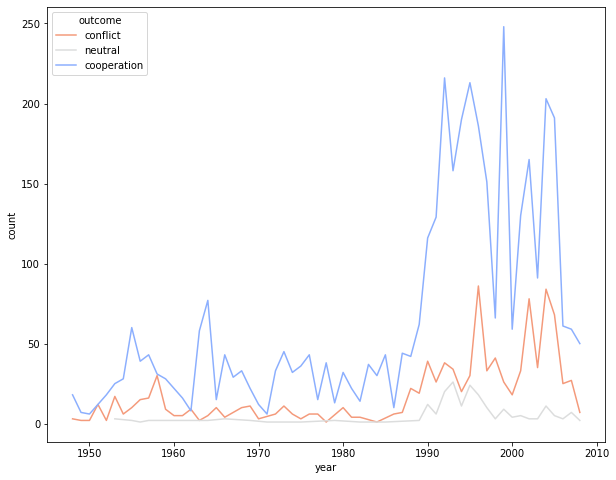

In [169]:
plt.figure(figsize=(10,8))
sns.lineplot(data=df6_4, x='year',y='count',hue='outcome',palette='coolwarm_r')


In [181]:
df6_2 

,number of treaties
year,
1948,241.0
1949,85.0
1950,59.0
1951,194.0
1952,215.0
...,...
2004,2605.0
2005,2284.0
2006,662.0


In [182]:
#maybe adding df6_2 to df6_4 would make sense

In [190]:
df6_4_1=pd.merge(df6_4,df6_2,how='left',left_on=['year'],right_on=['year'])

In [191]:
df6_4_1

,year,outcome,count,number of treaties
0,1948,conflict,3.0,241.0
1,1948,cooperation,18.0,241.0
2,1949,conflict,2.0,85.0
3,1949,cooperation,7.0,85.0
4,1950,conflict,2.0,59.0
...,...,...,...,...
149,2007,neutral,7.0,881.0
150,2007,cooperation,59.0,881.0
151,2008,conflict,7.0,630.0
152,2008,neutral,2.0,630.0


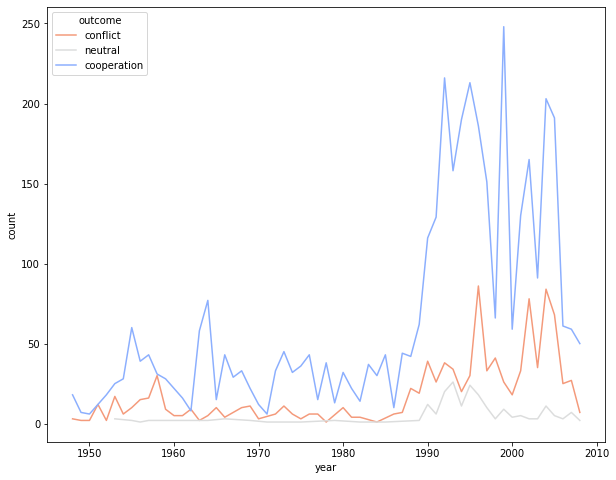

In [197]:
plt.figure(figsize=(10,8))
sns.lineplot(data=df6_4_1, x='year',y='count', hue='outcome',palette='coolwarm_r')


In [ ]:
####ML###
### convert strings to dummy variables
df6.columns

In [ ]:
df6=df6.drop(columns=['BCCODE','COUNTRY_LIST','PopDen12_P','Basin_Name','Pop_2015','Pop_2007','Pop_2020','PopDen2020','Pop_2012_P','PopDen12_P'])

In [ ]:
df6_ml = pd.get_dummies(df6, columns=['BCCODE1','BCCODE2','Continent_'], prefix=['one_hot_B1','one_hot_B2','one_hot_Continent'])
df6_ml

In [ ]:
df6_ml=df6_ml.drop(columns=['geometry'])

In [ ]:
#### Machine learning models

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

In [ ]:
sc = StandardScaler()
X = sc.fit_transform(df6_ml.drop('BAR_Scale', axis=1))
y = df6_ml['BAR_Scale']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import plot_confusion_matrix, classification_report, accuracy_score

In [ ]:
rfc = RandomForestClassifier()
rfc.fit(X_train, y_train)
pred = rfc.predict(X_test)
print(classification_report(y_test, pred))
print(accuracy_score(y_test, pred))


In [ ]:
#so my model is basically as good as a monkey, wunderbar!

In [ ]:
disp = plot_confusion_matrix(rfc, X_test, y_test,
                    )

disp.ax_.set_title("Confusion Matrix \n Random Forest")

In [ ]:
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.datasets import make_regression

In [ ]:
cls_lst = [KNeighborsClassifier(),
          SVC(),
          GaussianProcessClassifier(),
          DecisionTreeClassifier(),
          RandomForestClassifier(),
          AdaBoostClassifier(),
          GaussianNB(),
         
          ]

def evaluate(df, cls):
    accuracies = {}
    
    for cl in cls:
        sc = StandardScaler()
        X = sc.fit_transform(df6_ml.drop('BAR_Scale', axis=1))
        y = df6_ml['BAR_Scale']

        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=17)

        
        cl.fit(X_train, y_train)
        pred = cl.predict(X_test)
        # print(classification_report(y_test, pred))
        accuracies[cl.__class__.__name__] = accuracy_score(y_test, pred)
        #print(accuracy_score(y_test, pred))
    return accuracies

accuracy_dict = evaluate(df6_ml, cls_lst)


accuracy_df = pd.DataFrame(accuracy_dict, index=[0])

In [ ]:
accuracy_df.T.plot(kind='bar')

In [ ]:
from sklearn.linear_model import SGDRegressor
from sklearn.metrics import mean_squared_error,mean_absolute_error

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

In [ ]:
clf__ = SGDRegressor()
clf__.fit(X_train, y_train)
plt.scatter(y_test,clf__.predict(X_test))
plt.grid()
plt.xlabel('Actual y')
plt.ylabel('Predicted y')
plt.title('scatter plot between actual y and predicted y')
plt.show()
print('Mean Squared Error :',mean_squared_error(y_test, clf__.predict(X_test)))
print('Mean Absolute Error :',mean_absolute_error(y_test, clf__.predict(X_test)))

In [ ]:
#so choosing at random would be a better predictor in most cases
# lets try the same but leave out BCcode name 

In [ ]:
df6_ml2 = pd.get_dummies(df6, columns=['Continent_'], prefix=['one_hot_Continent'])
df6_ml2=df6_ml2.drop(columns=['BCCODE1','BCCODE2','geometry'])
df6_ml2

In [ ]:
cls_lst = [KNeighborsClassifier(),
          SVC(),
          GaussianProcessClassifier(),
          DecisionTreeClassifier(),
          RandomForestClassifier(),
          AdaBoostClassifier(),
          GaussianNB(),
         
          ]

def evaluate(df, cls):
    accuracies = {}
    
    for cl in cls:
        sc = StandardScaler()
        X = sc.fit_transform(df6_ml2.drop('BAR_Scale', axis=1))
        y = df6_ml['BAR_Scale']

        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=17)

        
        cl.fit(X_train, y_train)
        pred = cl.predict(X_test)
        # print(classification_report(y_test, pred))
        accuracies[cl.__class__.__name__] = accuracy_score(y_test, pred)
        #print(accuracy_score(y_test, pred))
    return accuracies

accuracy_dict = evaluate(df6_ml2, cls_lst)


accuracy_df2 = pd.DataFrame(accuracy_dict, index=[0])

In [ ]:
accuracy_df2.T.plot(kind='bar')